In [1]:
import os
import pandas as pd
import h5py
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
import io
import csv
import cv2





In [2]:
# Path to the file
base_path = "C:/Users/admin/Documents/DSTI/DeepLearning/Project/Computer_Vision/isic-2024-challenge"
train_metadata = pd.read_csv(os.path.join(base_path, "train-metadata.csv"))

C:\Users\admin\AppData\Local\Temp\ipykernel_5972\2178007341.py:3: DtypeWarning: Columns (51,52) have mixed types. Specify dtype option on import or set low_memory=False.
  train_metadata = pd.read_csv(os.path.join(base_path, "train-metadata.csv"))


In [3]:
# Quick overview of the metadata
print(train_metadata.head())
print(train_metadata.info())
print(train_metadata.describe())


        isic_id  target  patient_id  age_approx   sex anatom_site_general  \
0  ISIC_0015670       0  IP_1235828        60.0  male     lower extremity   
1  ISIC_0015845       0  IP_8170065        60.0  male           head/neck   
2  ISIC_0015864       0  IP_6724798        60.0  male     posterior torso   
3  ISIC_0015902       0  IP_4111386        65.0  male      anterior torso   
4  ISIC_0024200       0  IP_8313778        55.0  male      anterior torso   

   clin_size_long_diam_mm          image_type tbp_tile_type   tbp_lv_A  ...  \
0                    3.04  TBP tile: close-up     3D: white  20.244422  ...   
1                    1.10  TBP tile: close-up     3D: white  31.712570  ...   
2                    3.40  TBP tile: close-up        3D: XP  22.575830  ...   
3                    3.22  TBP tile: close-up        3D: XP  14.242329  ...   
4                    2.73  TBP tile: close-up     3D: white  24.725520  ...   

    lesion_id  iddx_full  iddx_1  iddx_2  iddx_3  iddx_4  iddx

In [4]:
# Check duplicates isic_id
duplicates = train_metadata.duplicated(subset='patient_id', keep=False)
duplicate_rows = train_metadata[duplicates]

# Number of duplicate
num_duplicates = duplicate_rows.shape[0]

# Display  results
print(f"Number of duplicate rows based on 'patient_id': {num_duplicates}")

  

Number of duplicate rows based on 'patient_id': 401054


In [5]:
#Display 10 first duplicate
print(duplicate_rows.head(10))

        isic_id  target  patient_id  age_approx     sex anatom_site_general  \
0  ISIC_0015670       0  IP_1235828        60.0    male     lower extremity   
1  ISIC_0015845       0  IP_8170065        60.0    male           head/neck   
2  ISIC_0015864       0  IP_6724798        60.0    male     posterior torso   
3  ISIC_0015902       0  IP_4111386        65.0    male      anterior torso   
4  ISIC_0024200       0  IP_8313778        55.0    male      anterior torso   
5  ISIC_0035502       0  IP_3026693        75.0  female           head/neck   
6  ISIC_0051648       0  IP_0218255        65.0    male     upper extremity   
7  ISIC_0051665       0  IP_7734648        50.0    male     posterior torso   
8  ISIC_0051710       0  IP_1307115        50.0    male      anterior torso   
9  ISIC_0051758       0  IP_2180091        60.0  female     upper extremity   

   clin_size_long_diam_mm          image_type tbp_tile_type   tbp_lv_A  ...  \
0                    3.04  TBP tile: close-up     3

In [6]:
# Example of duplicate
patient_ids = ['IP_1235828', 'IP_8170065']
is_patient_id = train_metadata['patient_id'].isin(patient_ids)
filtered_data = train_metadata[is_patient_id]
print(filtered_data)

             isic_id  target  patient_id  age_approx   sex  \
0       ISIC_0015670       0  IP_1235828        60.0  male   
1       ISIC_0015845       0  IP_8170065        60.0  male   
131     ISIC_0076432       0  IP_1235828        60.0  male   
2072    ISIC_0124587       0  IP_1235828        60.0  male   
2332    ISIC_0130299       0  IP_1235828        60.0  male   
...              ...     ...         ...         ...   ...   
397840  ISIC_9919878       0  IP_1235828        60.0  male   
398195  ISIC_9929307       0  IP_1235828        60.0  male   
398396  ISIC_9934582       0  IP_1235828        60.0  male   
399576  ISIC_9963797       0  IP_1235828        60.0  male   
400809  ISIC_9994034       0  IP_8170065        60.0  male   

       anatom_site_general  clin_size_long_diam_mm          image_type  \
0          lower extremity                    3.04  TBP tile: close-up   
1                head/neck                    1.10  TBP tile: close-up   
131        posterior torso       

We can see sevearl image per patient_id.In case of no proble, the variables lesion_id, iddx_2, iddx_3, iddx_4,  iddx_5, mel_mitotic_index,  mel_thick_mm have NA for value.

In [7]:
#Focus on NA for varaible age, sex, anatom
# Select columns 3-5 +ptient_Id
cols_2_to_5 = train_metadata.iloc[:, 2:6]


# dictionary to store results
results = {}

# Loop through each column
for col in cols_2_to_5:
    # Identify rows with NA values in the column
    na_rows = train_metadata[train_metadata[col].isna()]
    
    # Get the patient IDs associated
    patient_ids_with_na = na_rows['patient_id'].unique()
    
    # Check if these patient IDs have values in the same column
    filtered_data_patient_na = train_metadata[train_metadata['patient_id'].isin(patient_ids_with_na)]
    non_na_rows = filtered_data_patient_na.dropna(subset=[col])
    
    # Count the number of rows for these patient IDs where the column has data
    count_non_na_rows = len(non_na_rows)
    
    # Store the results
    results[col] = {
        'number_of_na': len(na_rows),
        'number_of_unique_patient_ids_with_na': len(patient_ids_with_na),
        'number_of_rows_with_data': count_non_na_rows
    }

# Display the results
for col, res in results.items():
    print(f"Column: {col}")
    print(f"  Number of NA values: {res['number_of_na']}")
    print(f"  Number of unique patient IDs with NA: {res['number_of_unique_patient_ids_with_na']}")
    print(f"  Number of rows with data for these patient IDs: {res['number_of_rows_with_data']}")
    print()


Column: patient_id
  Number of NA values: 0
  Number of unique patient IDs with NA: 0
  Number of rows with data for these patient IDs: 0

Column: age_approx
  Number of NA values: 2798
  Number of unique patient IDs with NA: 13
  Number of rows with data for these patient IDs: 0

Column: sex
  Number of NA values: 11517
  Number of unique patient IDs with NA: 33
  Number of rows with data for these patient IDs: 0

Column: anatom_site_general
  Number of NA values: 5756
  Number of unique patient IDs with NA: 35
  Number of rows with data for these patient IDs: 14977



In [8]:
# Zero value
#Exluding column 1
columns_to_zero = train_metadata.drop(train_metadata.columns[1], axis=1)

# Identify rows with at least one zero value, wo column 1
zero_mask = columns_to_zero.eq(0).any(axis=1)
rows_with_zero = train_metadata[zero_mask]


# Nber of rows
print(f"Number of rows with at least one zero value: {len(rows_with_zero)}")

# Display the rows
if len(rows_with_zero) > 0:
    print("Rows with at least one zero value:")
    print(rows_with_zero)
else:
    print("No rows with zero values found.")

Number of rows with at least one zero value: 47205
Rows with at least one zero value:
             isic_id  target  patient_id  age_approx     sex  \
0       ISIC_0015670       0  IP_1235828        60.0    male   
1       ISIC_0015845       0  IP_8170065        60.0    male   
2       ISIC_0015864       0  IP_6724798        60.0    male   
4       ISIC_0024200       0  IP_8313778        55.0    male   
5       ISIC_0035502       0  IP_3026693        75.0  female   
...              ...     ...         ...         ...     ...   
401005  ISIC_9998933       0  IP_4211990        55.0  female   
401006  ISIC_9998938       0  IP_5296073        60.0    male   
401008  ISIC_9999003       0  IP_4106376        65.0    male   
401020  ISIC_9999207       0  IP_4506900        40.0    male   
401049  ISIC_9999817       0  IP_1117889        55.0  female   

       anatom_site_general  clin_size_long_diam_mm          image_type  \
0          lower extremity                    3.04  TBP tile: close-up 

check for variable color if value =0 is ok

In [9]:
#Number of unique patient
# Drop duplicate rows based on 'patient_id'
unique_patients = train_metadata.drop_duplicates(subset='patient_id')
unique_patients_count=unique_patients.value_counts()
# Display
print(f"Number of unique patient: {unique_patients_count}")


#Number of picture by patient
photo_counts = train_metadata.groupby('patient_id').size()

# Average Nber
average_photos_per_patient = photo_counts.mean()

# Display
print(f"Average number of photos per patient: {average_photos_per_patient:.2f}")


Number of unique patient: Series([], Name: count, dtype: int64)
Average number of photos per patient: 384.89


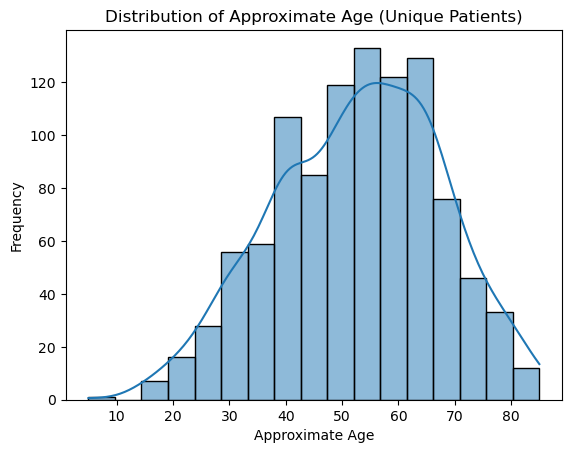

In [10]:
# Distribution plot of age 
sns.histplot(unique_patients['age_approx'], kde=True)
plt.title("Distribution of Approximate Age (Unique Patients)")
plt.xlabel("Approximate Age")
plt.ylabel("Frequency")
plt.show()

In [11]:
# Select columns without NA
column_wo_na = train_metadata.iloc[:, list(range(6, 44)) + list(range(46, 47)) + [54]]


# Display
print(column_wo_na)

        clin_size_long_diam_mm          image_type tbp_tile_type   tbp_lv_A  \
0                         3.04  TBP tile: close-up     3D: white  20.244422   
1                         1.10  TBP tile: close-up     3D: white  31.712570   
2                         3.40  TBP tile: close-up        3D: XP  22.575830   
3                         3.22  TBP tile: close-up        3D: XP  14.242329   
4                         2.73  TBP tile: close-up     3D: white  24.725520   
...                        ...                 ...           ...        ...   
401054                    6.80  TBP tile: close-up        3D: XP  22.574335   
401055                    3.11  TBP tile: close-up     3D: white  19.977640   
401056                    2.05  TBP tile: close-up        3D: XP  17.332567   
401057                    2.80  TBP tile: close-up        3D: XP  22.288570   
401058                    3.30  TBP tile: close-up        3D: XP  16.792900   

        tbp_lv_Aext   tbp_lv_B  tbp_lv_Bext   tbp_l

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


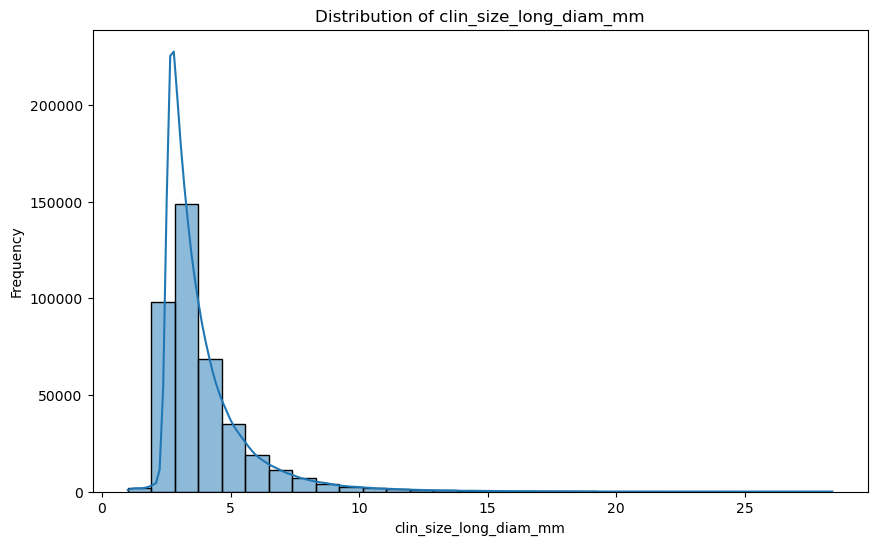

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


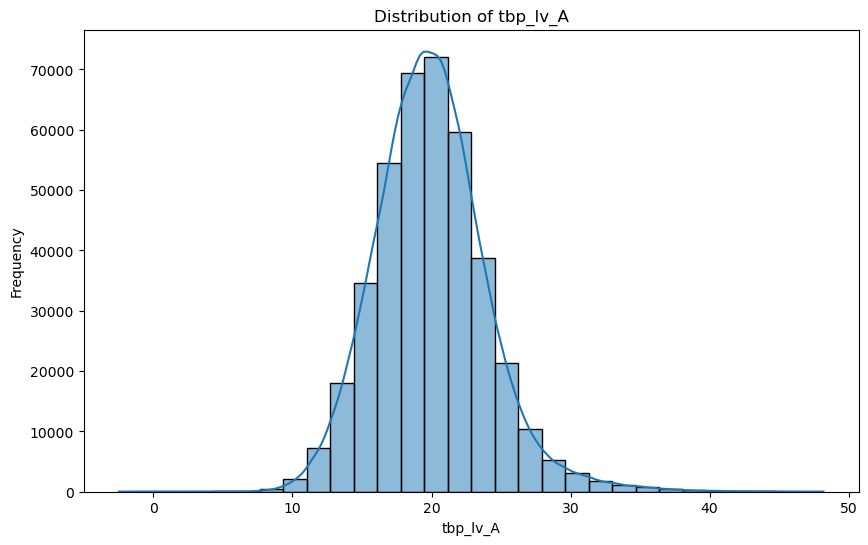

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


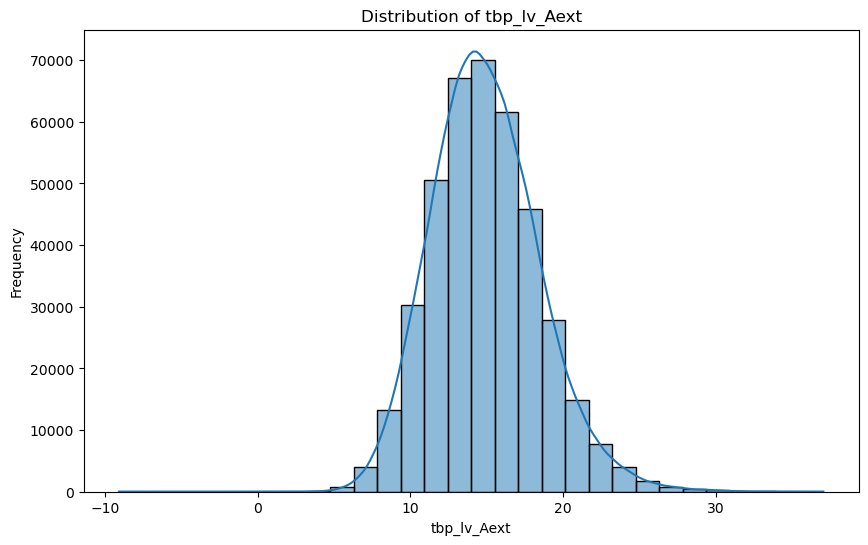

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


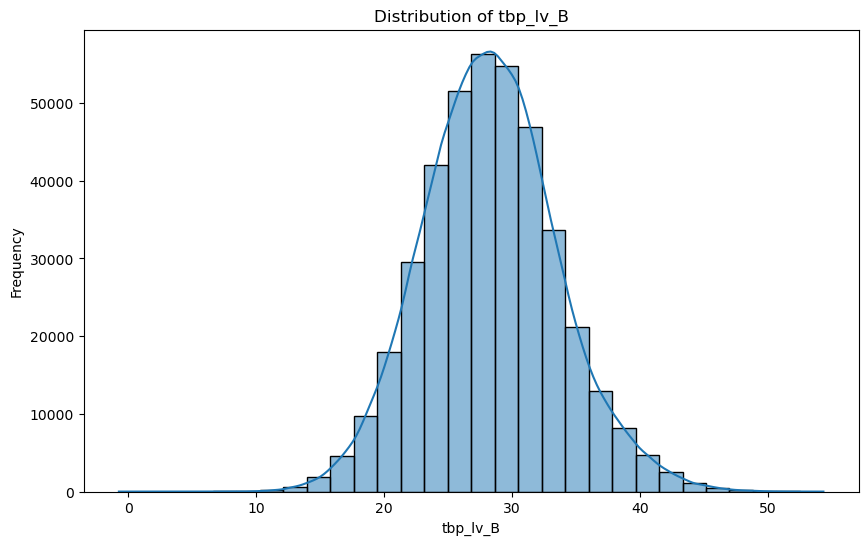

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


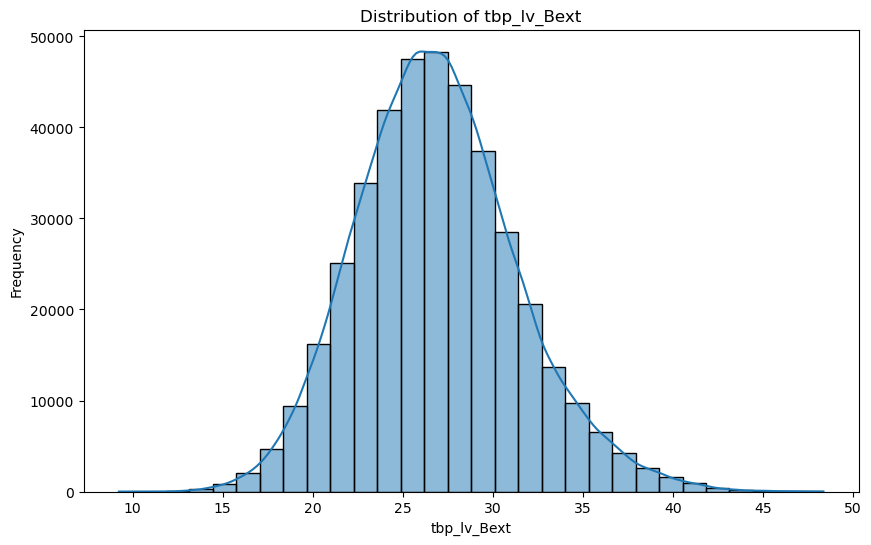

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


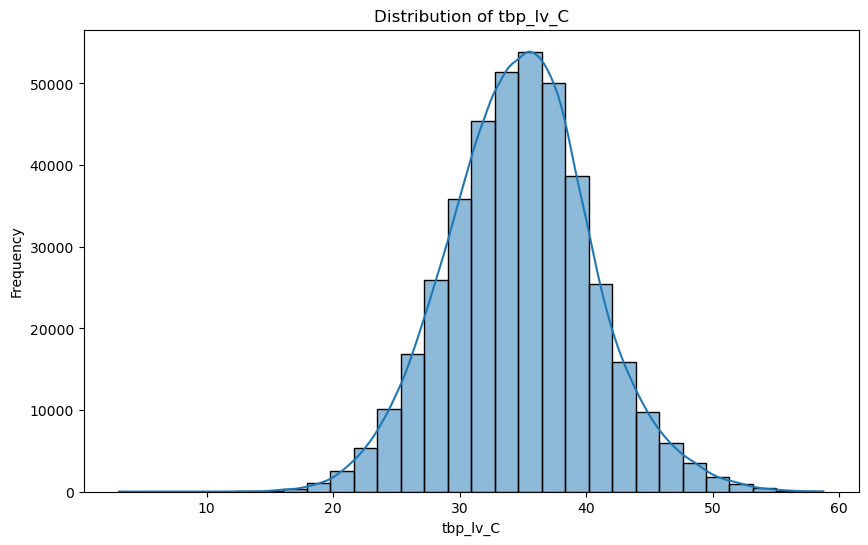

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


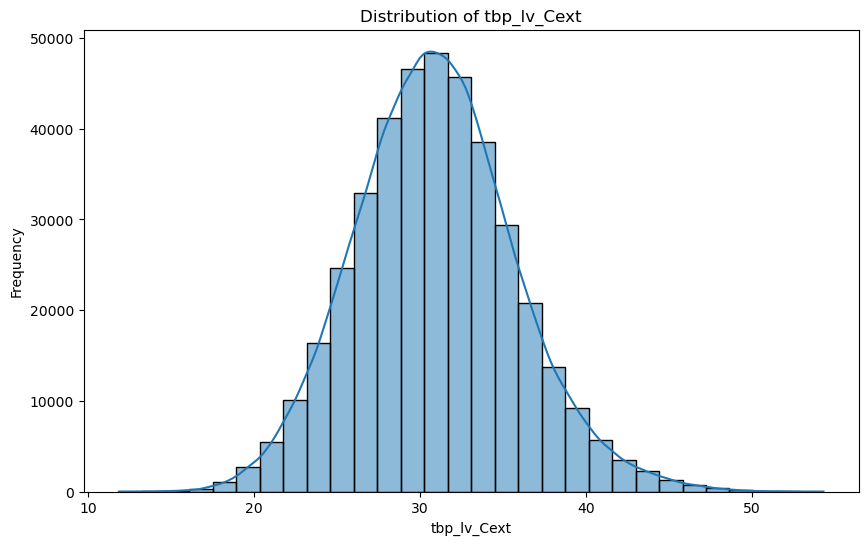

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


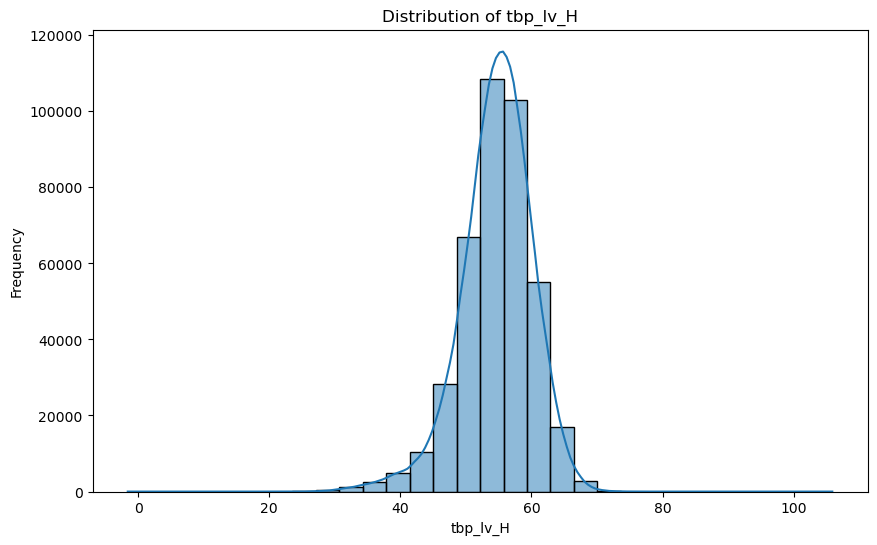

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


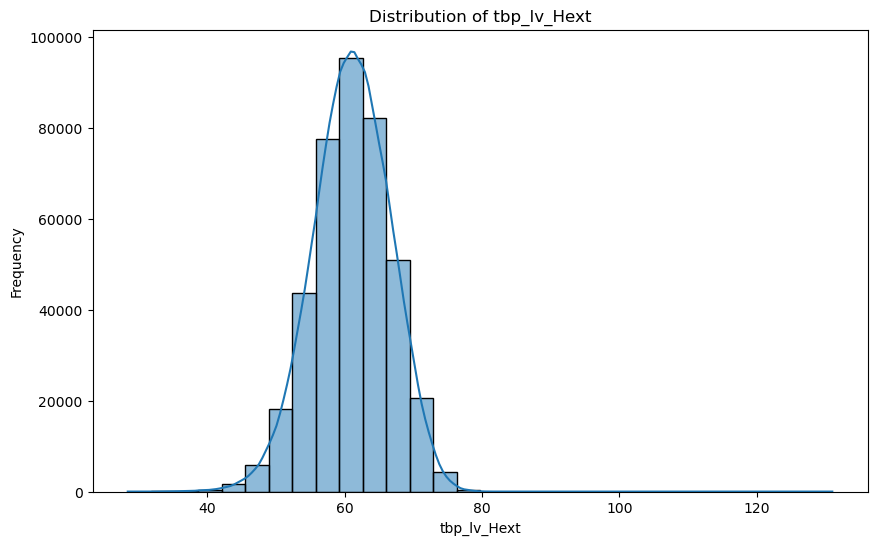

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


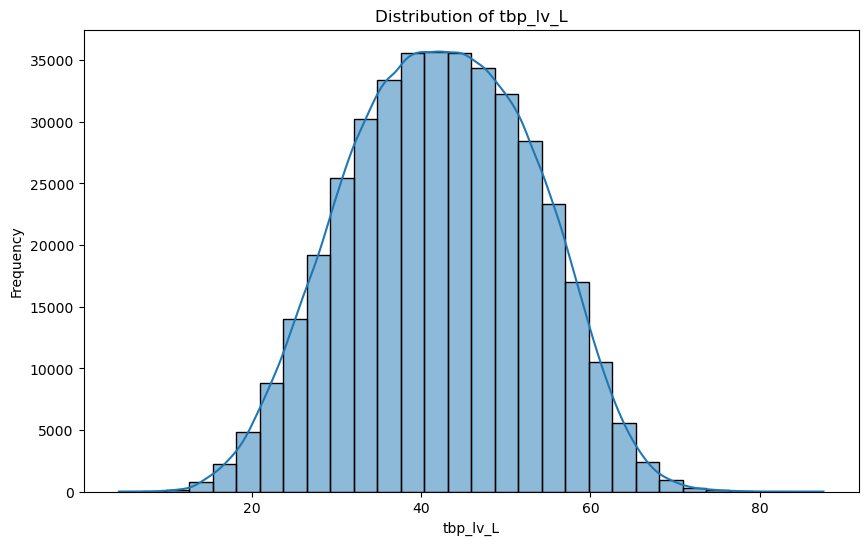

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


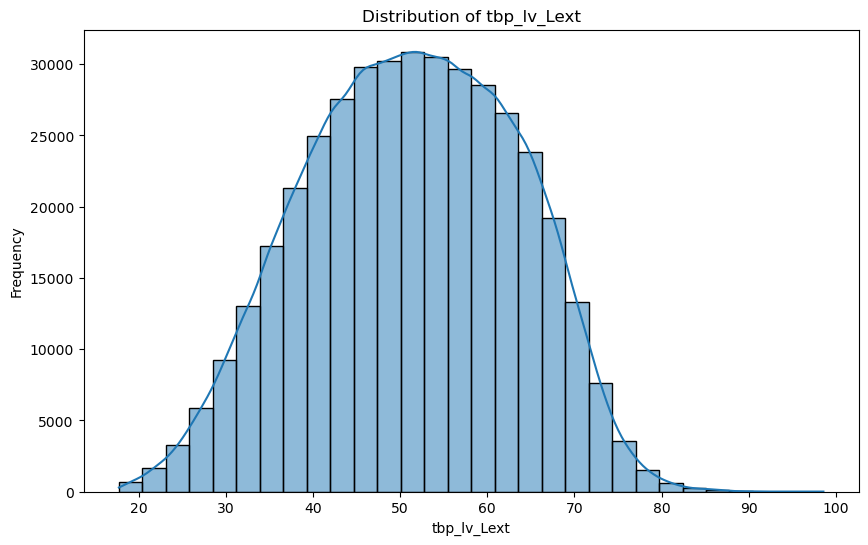

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


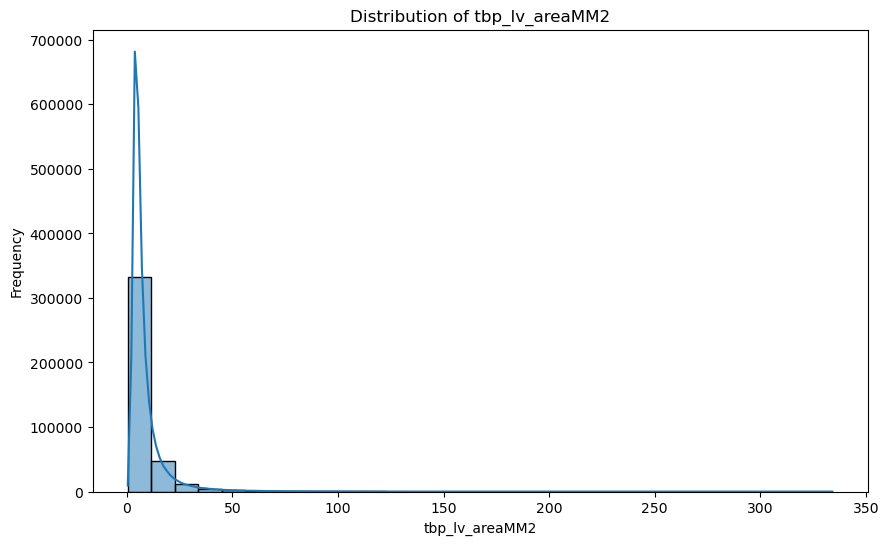

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


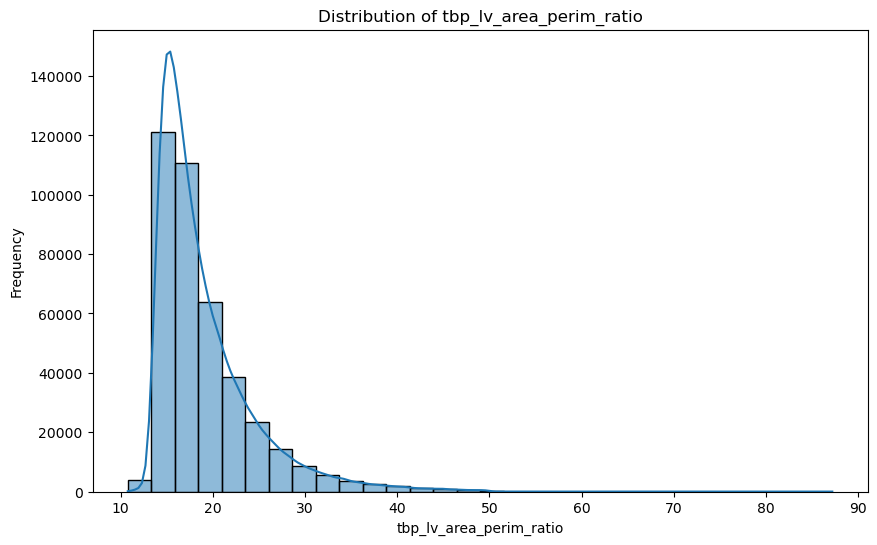

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


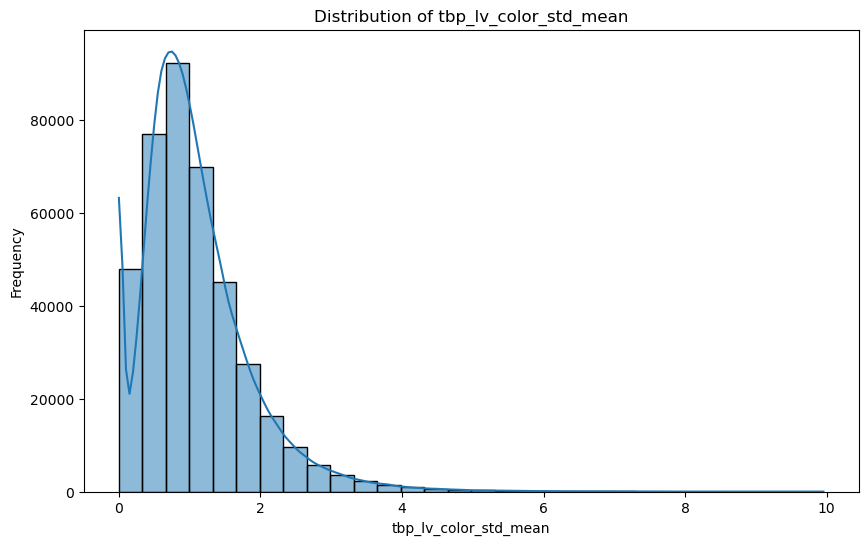

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


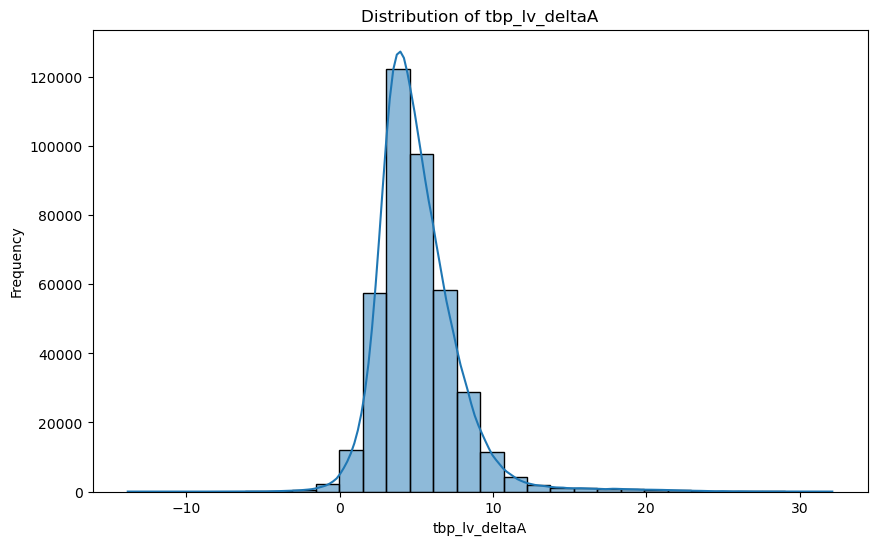

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


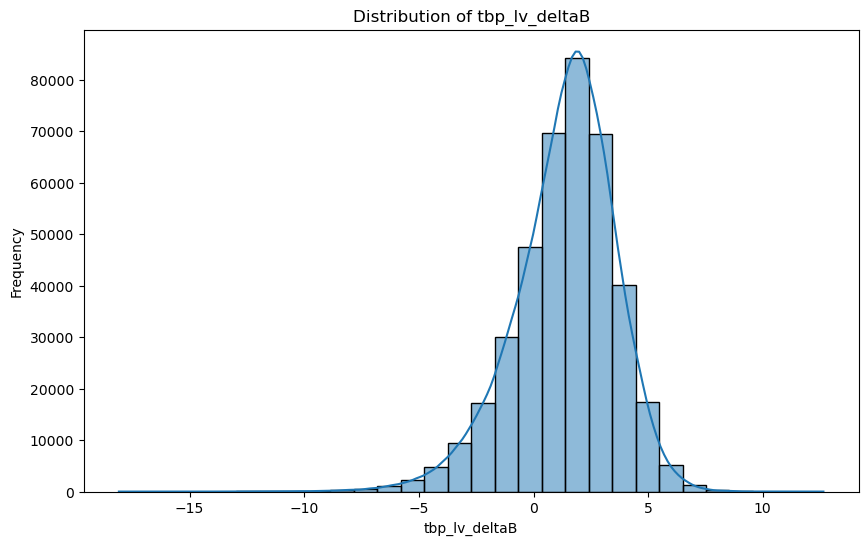

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


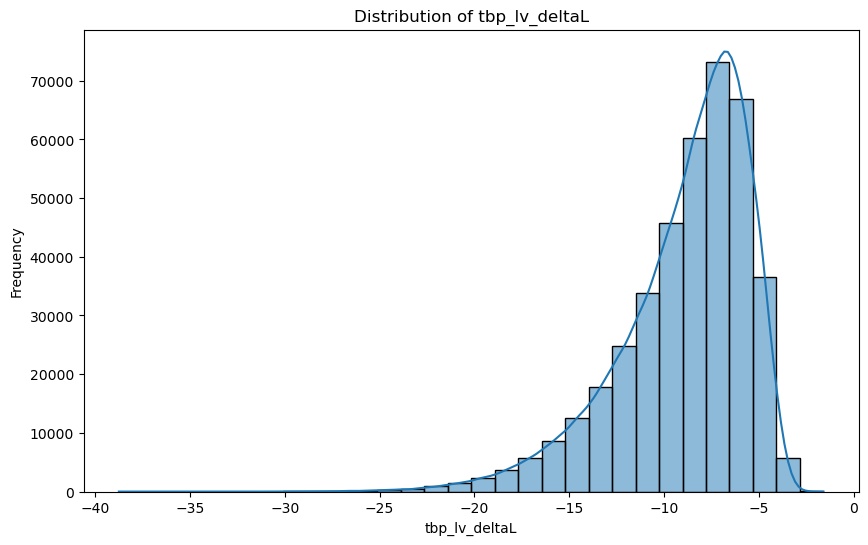

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


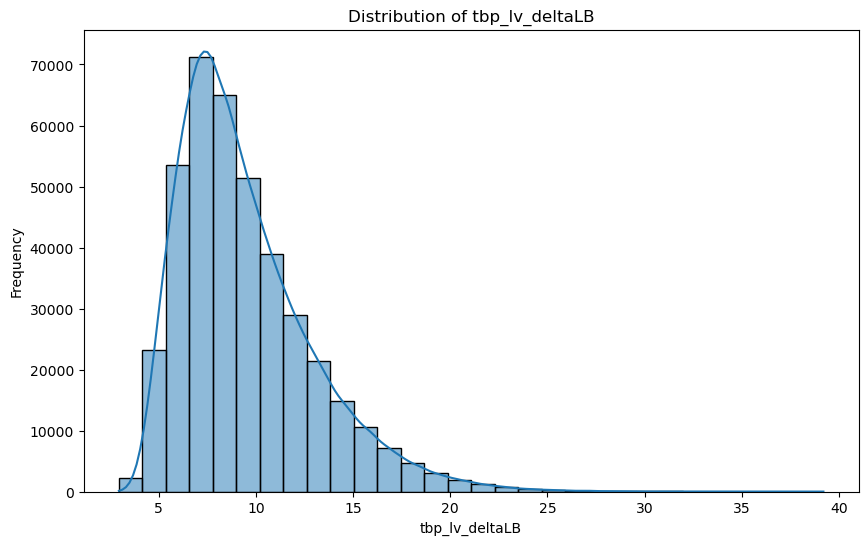

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


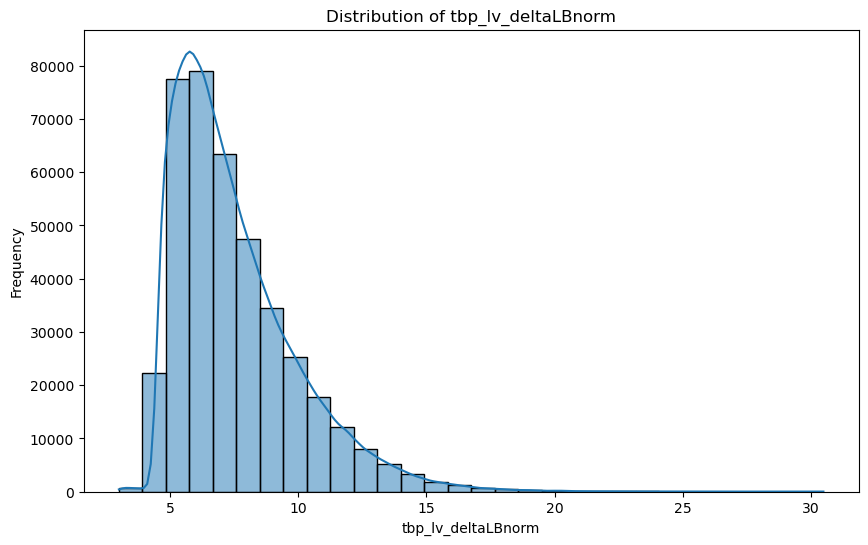

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


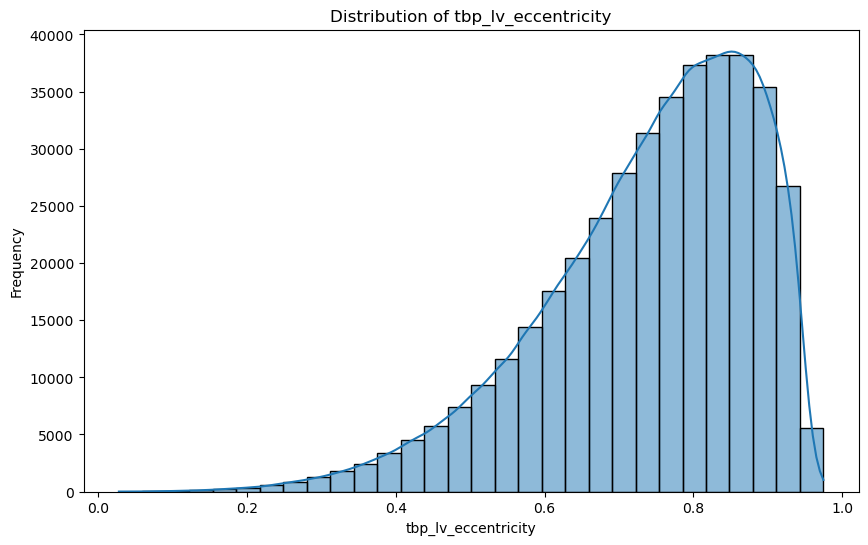

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


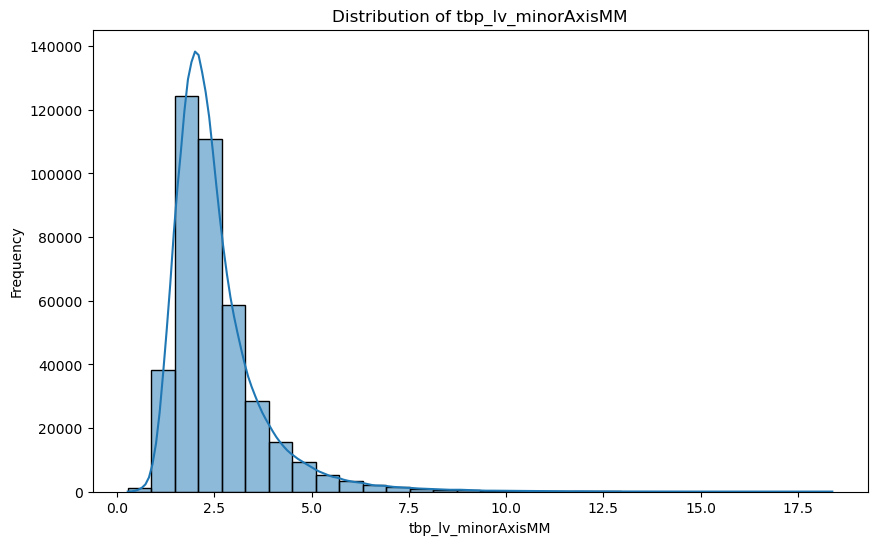

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


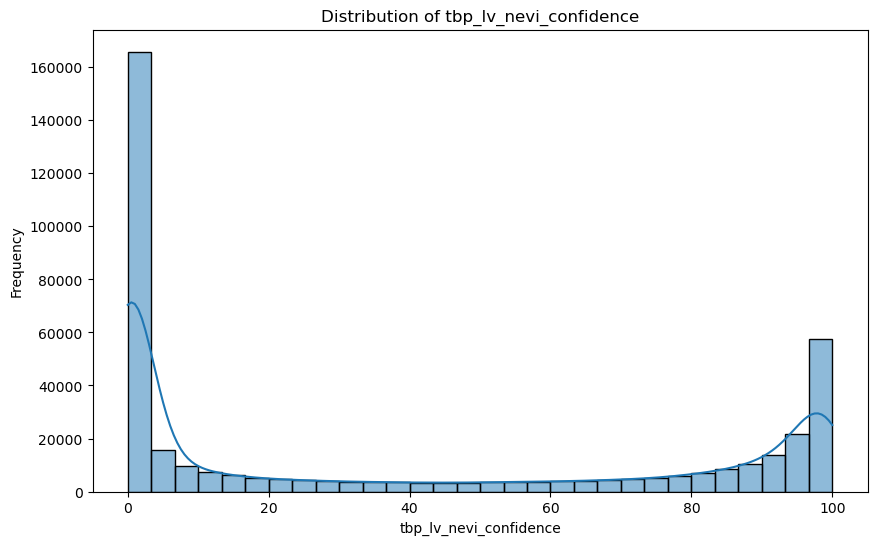

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


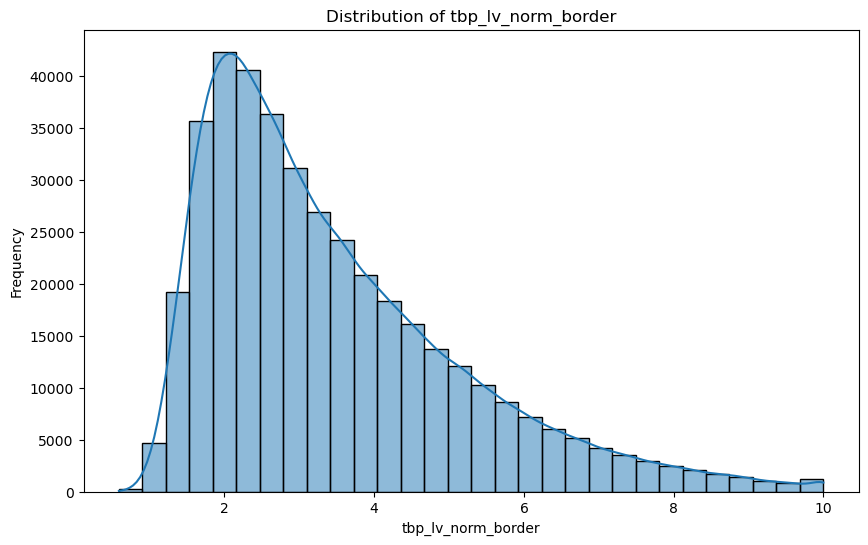

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


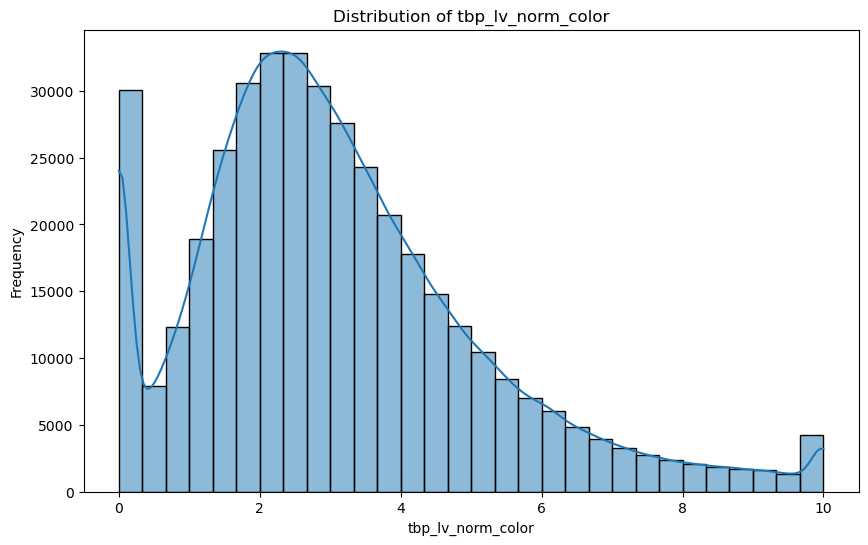

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


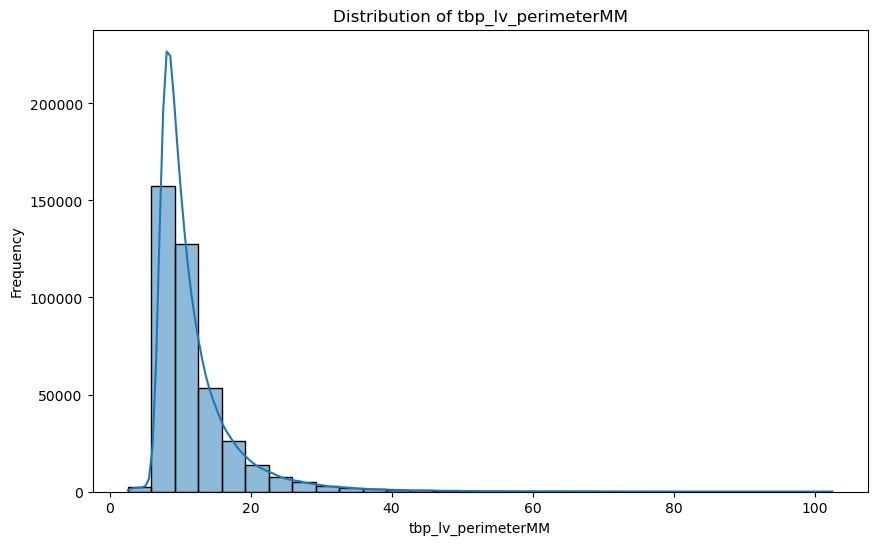

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


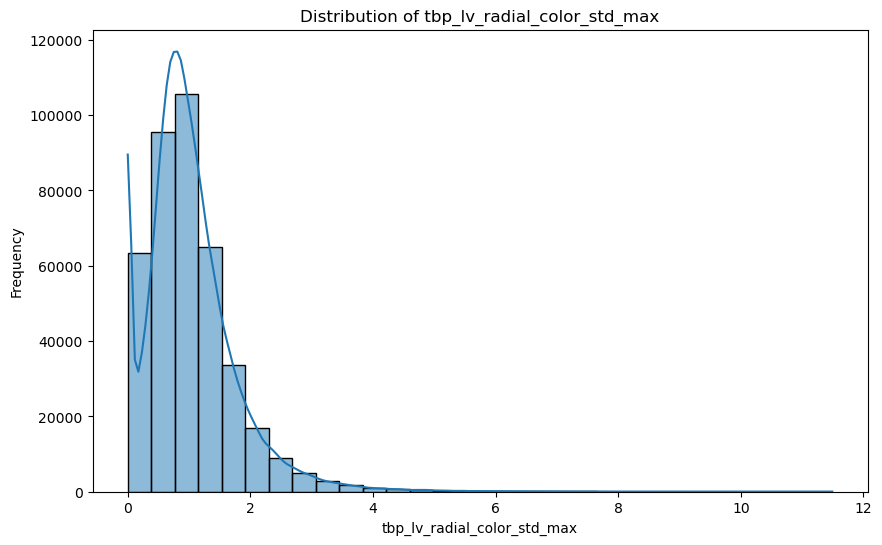

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


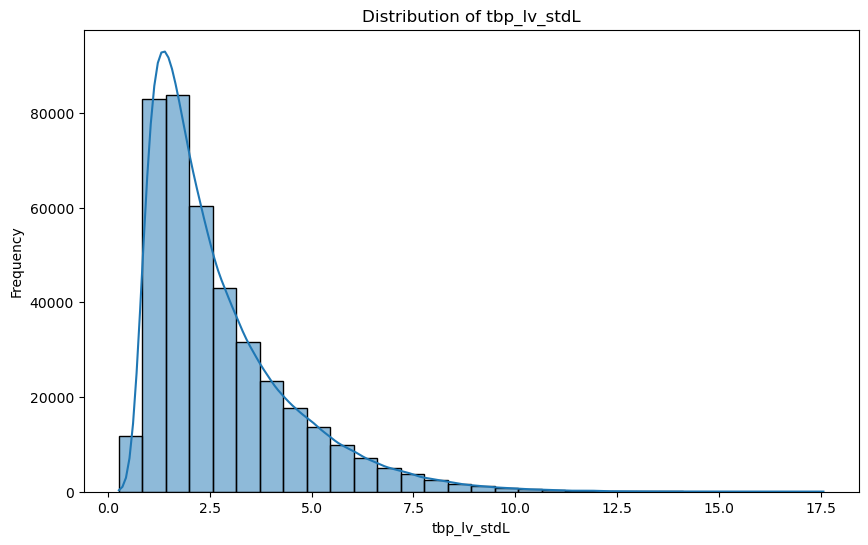

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


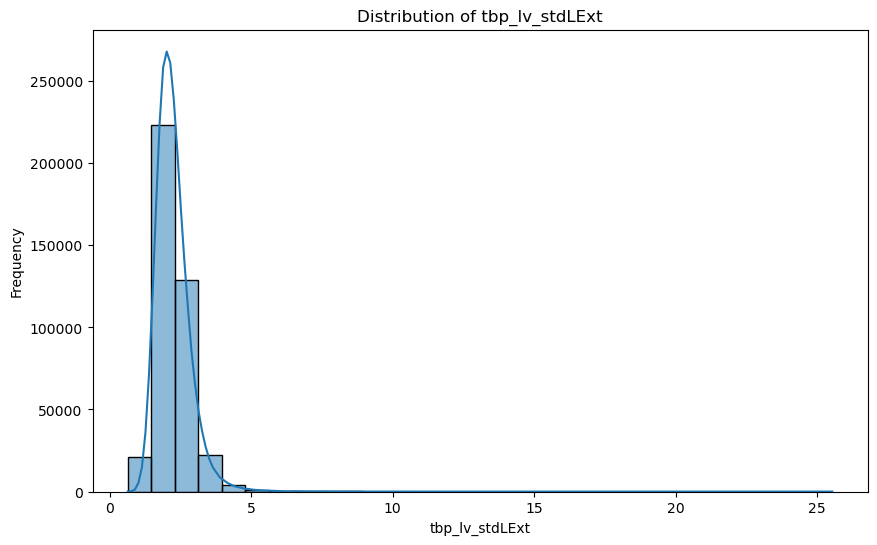

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


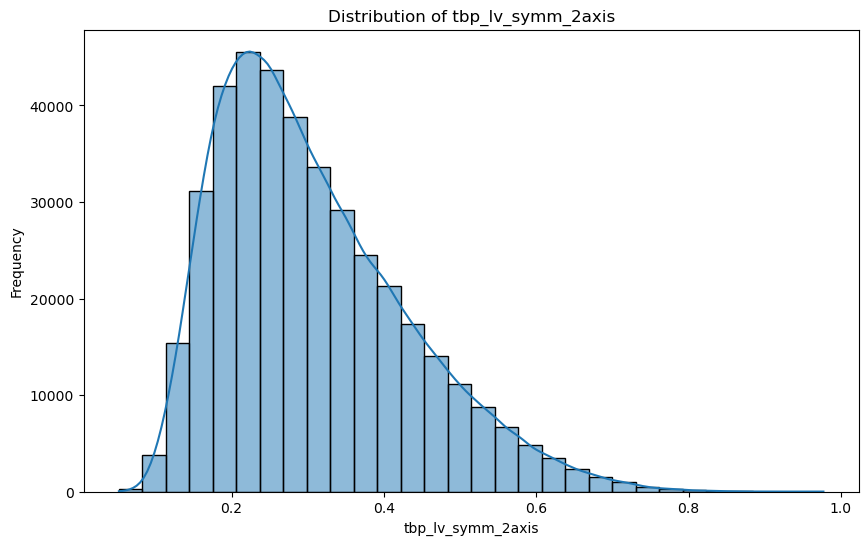

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


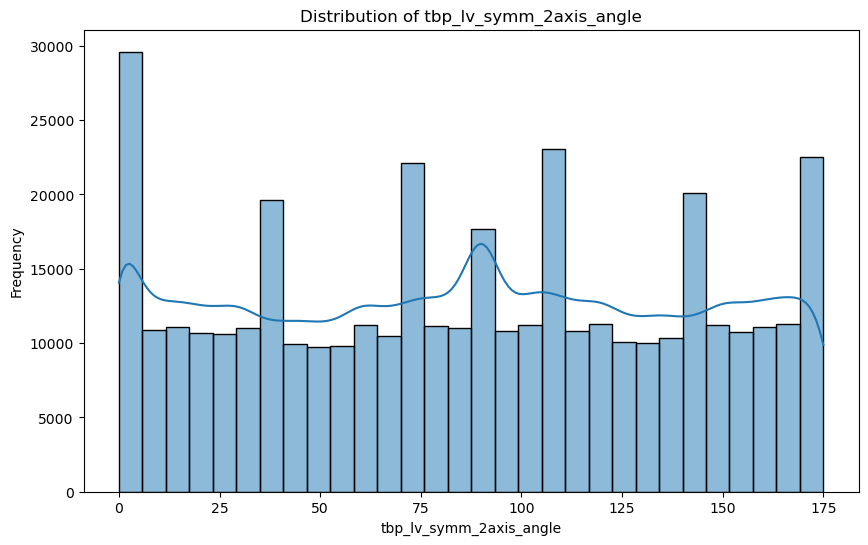

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


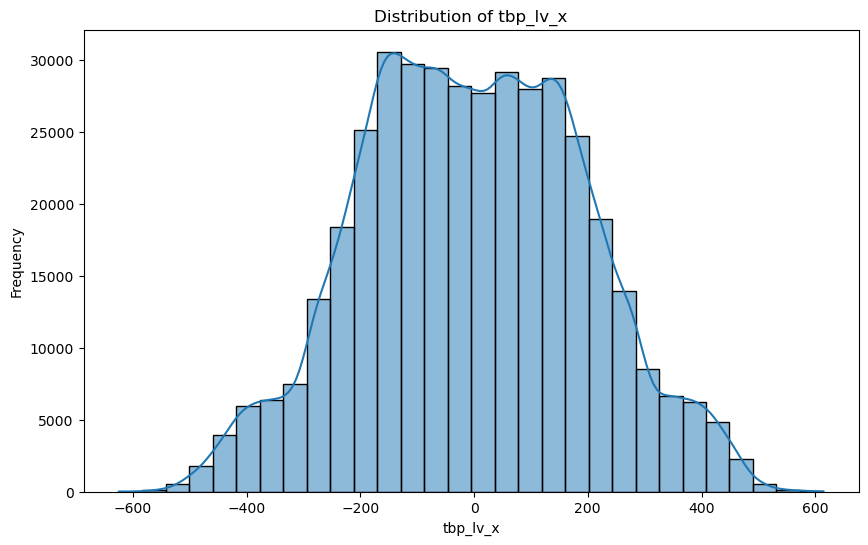

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


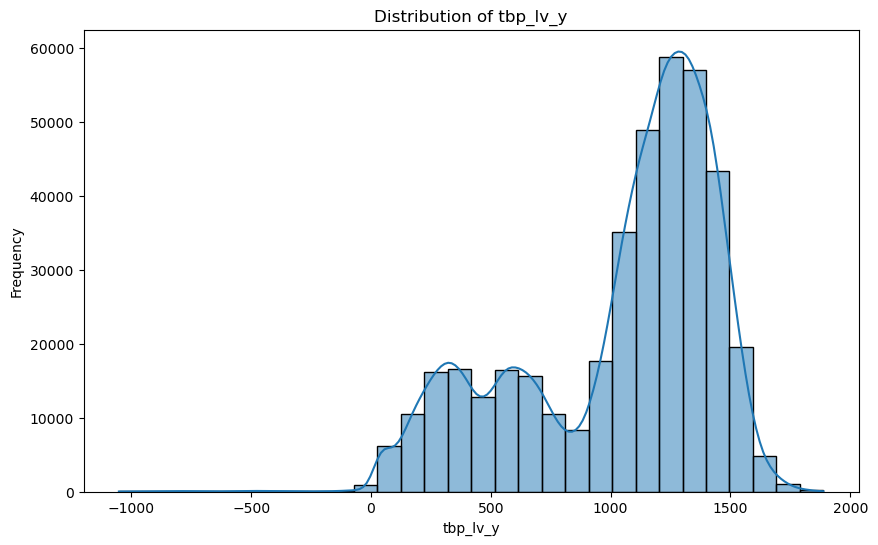

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


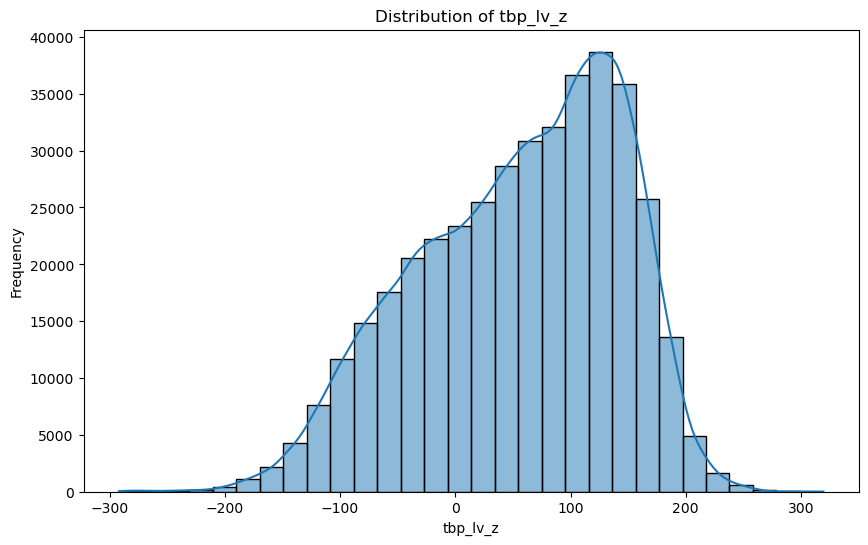

C:\ProgramData\anaconda3\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


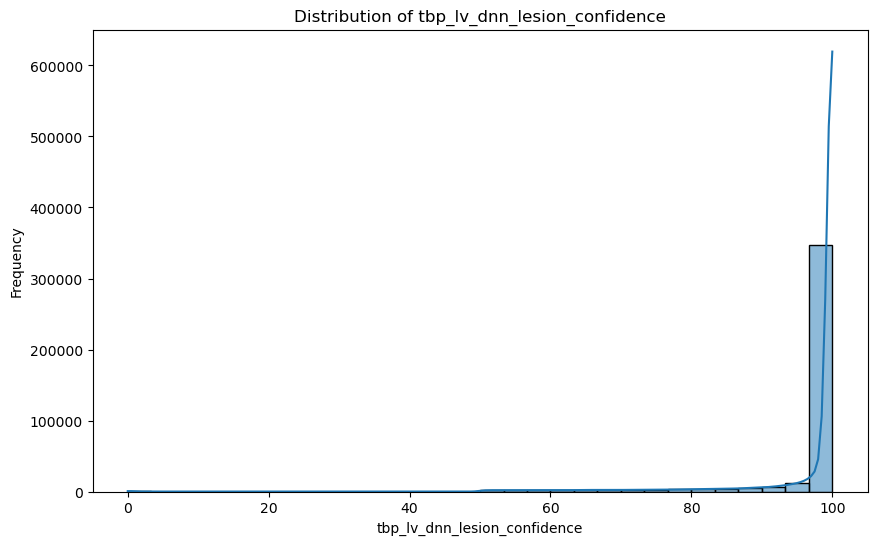

In [15]:
def plot_distribution(dataframe, columns=None):
    # If no columns, select all numerical columns
    if columns is None:
        columns = dataframe.select_dtypes(include=['int', 'float'])
    
    # If column specified, plot the distribution
    for column in columns:
        plt.figure(figsize=(10, 6))
        sns.histplot(dataframe[column], kde=True, bins=30)
        plt.title(f'Distribution of {column}')
        plt.xlabel(column)
        plt.ylabel('Frequency')
        plt.show()
column_wo_na_num=column_wo_na.select_dtypes(include=['int', 'float'])
plot_distribution(train_metadata,column_wo_na_num)

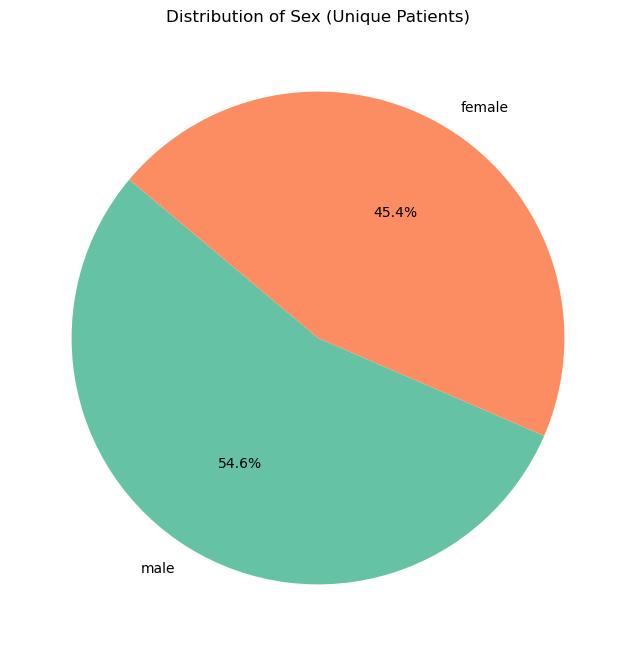

In [12]:
# Plot the distribution of 'sex' for unique patients
sex_counts = unique_patients['sex'].value_counts()

# Plot the pie chart
plt.figure(figsize=(8, 8))
plt.pie(sex_counts, labels=sex_counts.index, autopct='%1.1f%%', startangle=140, colors=sns.color_palette("Set2"))
plt.title("Distribution of Sex (Unique Patients)")
plt.show()

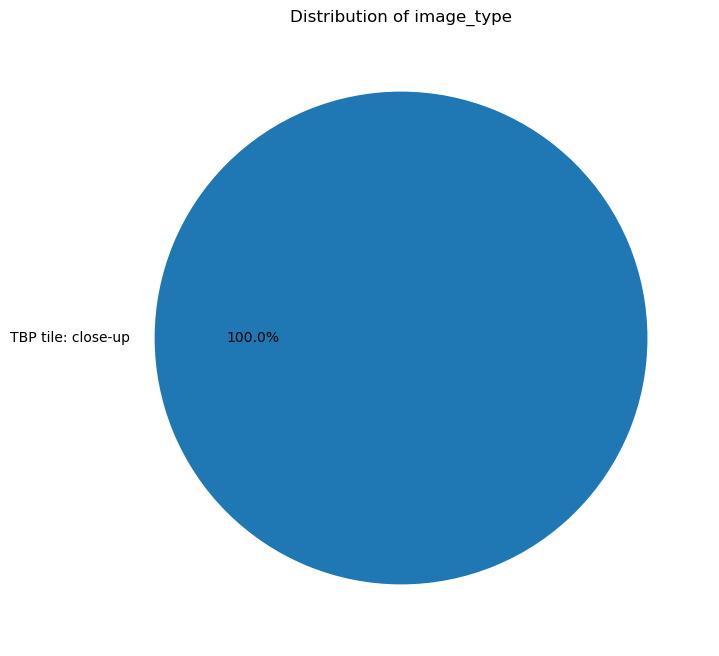

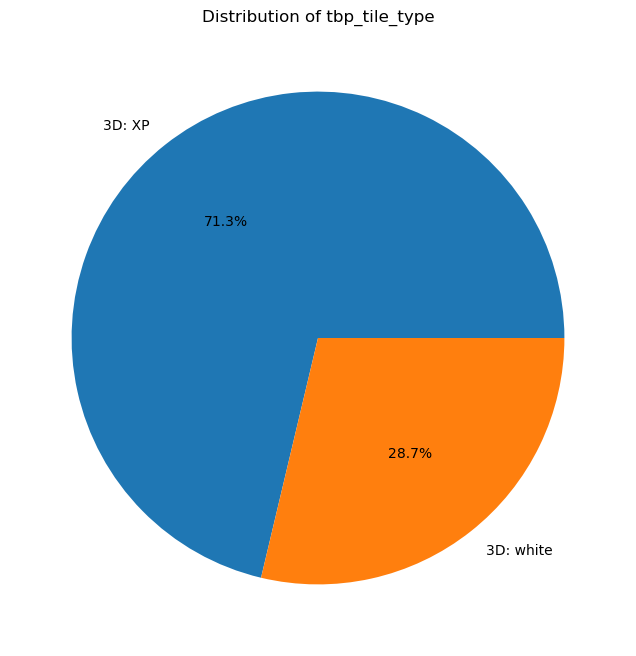

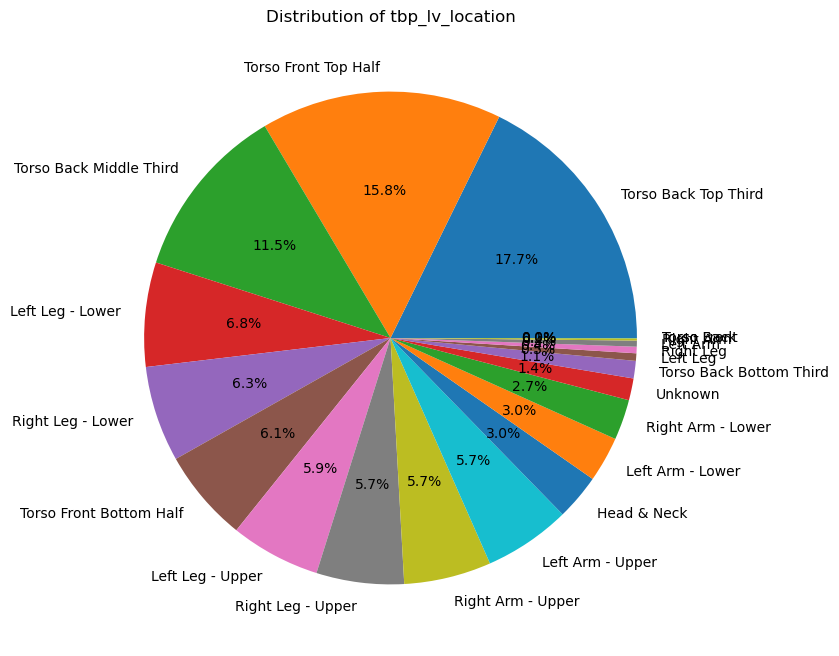

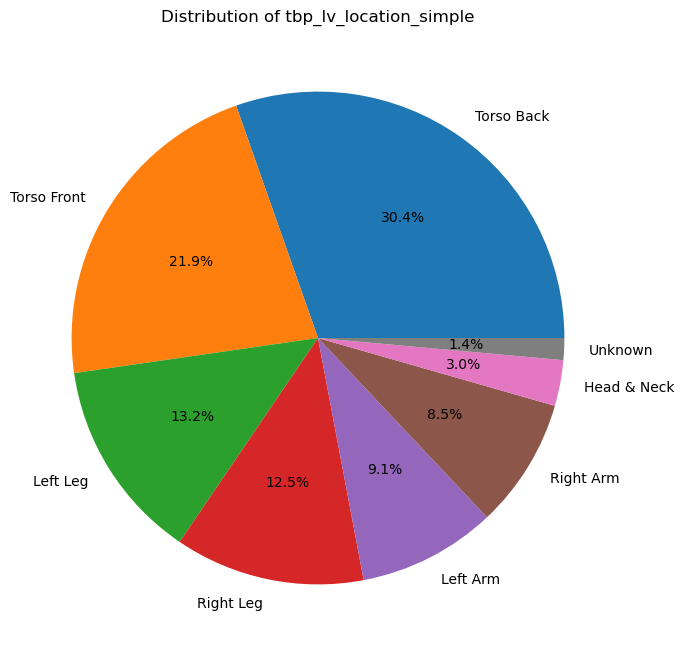

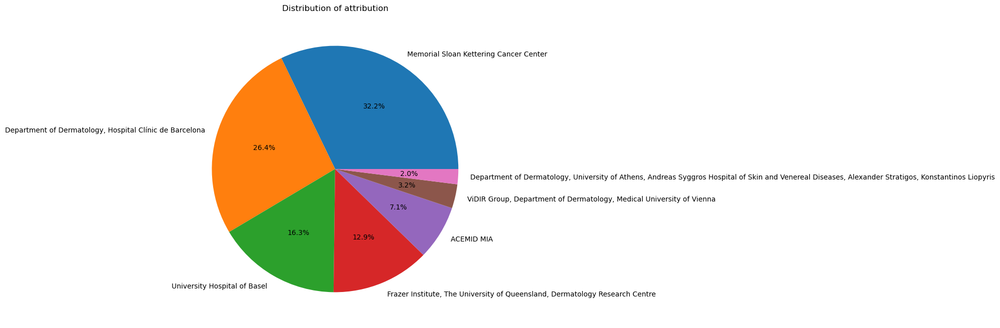

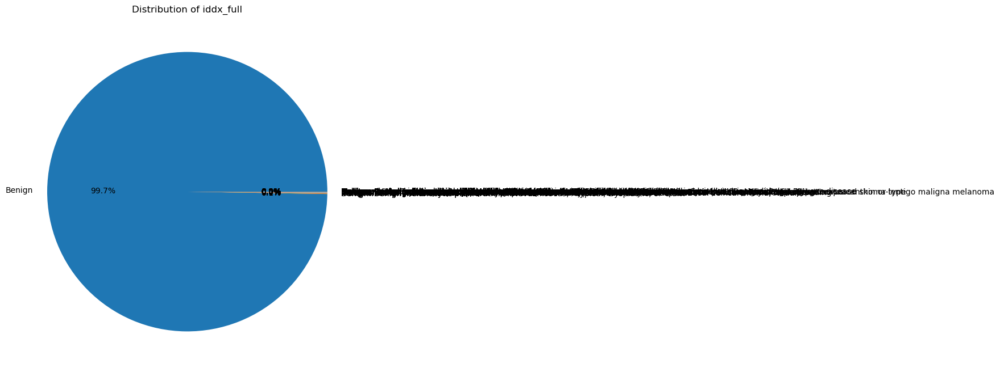

In [13]:
def plot_pie_charts(dataframe, columns=None):
    # If no columns , select all categorical columns
    if columns is None:
        columns = dataframe.select_dtypes(include=['object'])

    
    # If column specified, plot pie chart
    for column in columns:

        plt.figure(figsize=(8, 8))
        value_counts = dataframe[column].value_counts()
        plt.pie(value_counts, labels=value_counts.index, autopct='%1.1f%%')
        plt.title(f'Distribution of {column}')
       # plt.ylabel('')
        plt.show()

column_wo_na_obj=column_wo_na.select_dtypes(include=['object'])
plot_pie_charts(train_metadata,column_wo_na_obj)



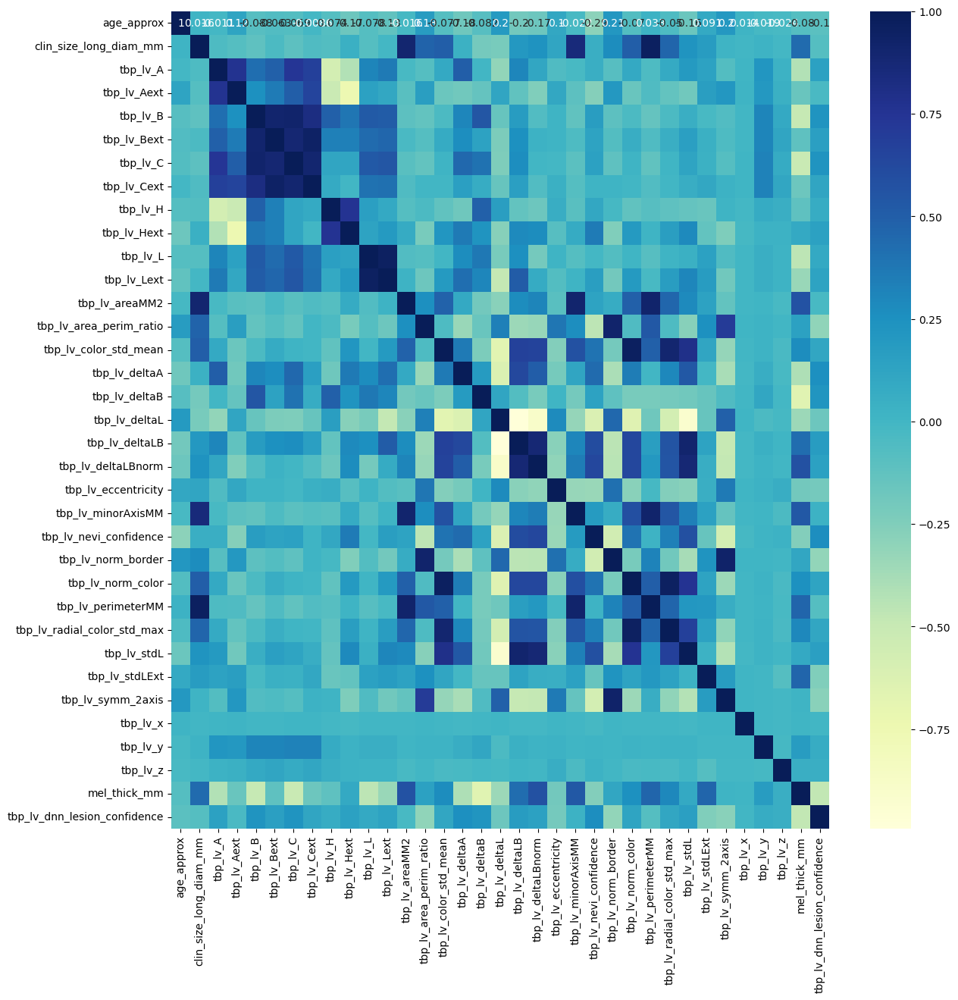

In [25]:
# Correlation matrix
column_numeric = train_metadata.select_dtypes(include = ['float'])


# Calculate the correlation matrix
column_numeric.corr()

plt.figure(figsize = (14,14))
sns.heatmap(column_numeric.corr(), annot = True, cmap = 'YlGnBu')
plt.show()


In [12]:

hdf5_file_path = os.path.join(base_path, "train-image.hdf5")

# The ID to check
dataset_id = 'ISIC_0015670'

# Open the HDF5 file in read-only mode
with h5py.File(hdf5_file_path, 'r') as file:
    # Check if the ID exists in the file
    if dataset_id in file:
        # Access the dataset
        data = file[dataset_id]
        
        # If it's a dataset, display some details
        if isinstance(data, h5py.Dataset):
            print(f"Dataset found: {dataset_id}")
            print(f"Shape: {data.shape}, Data Type: {data.dtype}")
            
            dataset_data = data[()]  
            print("Extracted data:")
            print(dataset_data)  # Display the scalar data
            
        elif isinstance(data, h5py.Group):
            print(f"Group found: {dataset_id}")
      
            print("Group contents:", list(data.keys()))
    else:
        print(f"The ID {dataset_id} does not exist in the HDF5 file.")


Dataset found: ISIC_0015670
Shape: (), Data Type: |S3325
Extracted data:
b'\xff\xd8\xff\xe0\x00\x10JFIF\x00\x01\x01\x00\x00\x01\x00\x01\x00\x00\xff\xdb\x00C\x00\x08\x06\x06\x07\x06\x05\x08\x07\x07\x07\t\t\x08\n\x0c\x14\r\x0c\x0b\x0b\x0c\x19\x12\x13\x0f\x14\x1d\x1a\x1f\x1e\x1d\x1a\x1c\x1c $.\' ",#\x1c\x1c(7),01444\x1f\'9=82<.342\xff\xdb\x00C\x01\t\t\t\x0c\x0b\x0c\x18\r\r\x182!\x1c!22222222222222222222222222222222222222222222222222\xff\xc0\x00\x11\x08\x00\x8b\x00\x8b\x03\x01"\x00\x02\x11\x01\x03\x11\x01\xff\xc4\x00\x1f\x00\x00\x01\x05\x01\x01\x01\x01\x01\x01\x00\x00\x00\x00\x00\x00\x00\x00\x01\x02\x03\x04\x05\x06\x07\x08\t\n\x0b\xff\xc4\x00\xb5\x10\x00\x02\x01\x03\x03\x02\x04\x03\x05\x05\x04\x04\x00\x00\x01}\x01\x02\x03\x00\x04\x11\x05\x12!1A\x06\x13Qa\x07"q\x142\x81\x91\xa1\x08#B\xb1\xc1\x15R\xd1\xf0$3br\x82\t\n\x16\x17\x18\x19\x1a%&\'()*456789:CDEFGHIJSTUVWXYZcdefghijstuvwxyz\x83\x84\x85\x86\x87\x88\x89\x8a\x92\x93\x94\x95\x96\x97\x98\x99\x9a\xa2\xa3\xa4\xa5\xa6\xa7\xa8\xa9\xaa\xb2\xb3

In [16]:
# Load the sample submission data
sample_submission = pd.read_csv(os.path.join(base_path, "sample_submission.csv"))
# Load the file
hdf5_file_path=os.path.join(base_path, "train-image.hdf5")
with h5py.File(hdf5_file_path, 'r') as hdf:
    # Extract the image data for the specified ID
    image_data = {}
    for isic_id in sample_submission['isic_id']:
        if isic_id in hdf:
            image_data[isic_id] = np.array(hdf[isic_id])
        else:
            print(f"ISIC ID {isic_id} not found in the HDF5 file.")

# Analyze the extracted image data
for isic_id, image in image_data.items():
    print(f"Analysis for {isic_id}:")
    print(f" - Shape: {image.shape}")
    print(f" - Width: {image.shape[1]}")
    print(f" - Height: {image.shape[0]}")
    print(f" - Channels: {image.shape[2] if len(image.shape) > 2 else 1}")
    print(f" - Data type: {image.dtype}")
    print(f" - Min pixel value: {image.min()}")
    print(f" - Max pixel value: {image.max()}")
    print(f" - Mean pixel value: {image.mean()}")
    print()

ISIC ID ISIC_0015657 not found in the HDF5 file.
ISIC ID ISIC_0015729 not found in the HDF5 file.
ISIC ID ISIC_0015740 not found in the HDF5 file.


Analysis for ISIC_0015670:


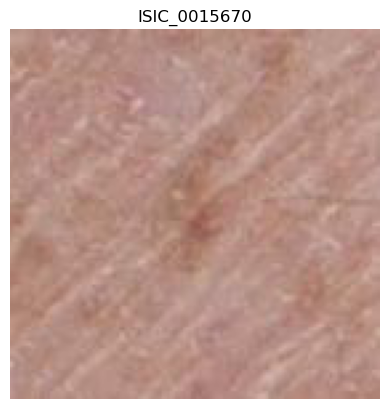

 - Shape: (139, 139, 3)
 - Width: 139
 - Height: 139
 - Min pixel value: 79
 - Max pixel value: 223
 - Mean pixel value: 151.78643272432413

Analysis for ISIC_0015845:


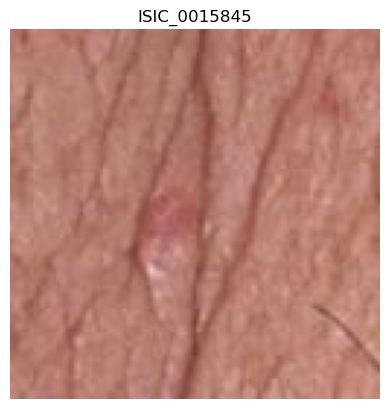

 - Shape: (127, 127, 3)
 - Width: 127
 - Height: 127
 - Min pixel value: 46
 - Max pixel value: 250
 - Mean pixel value: 137.71312542625085



In [13]:
# ID picture to analiize
image_ids_to_analyze = ['ISIC_0015670', 'ISIC_0015845']

# Load File
hdf5_file_path = os.path.join(base_path, "train-image.hdf5")
with h5py.File(hdf5_file_path, 'r') as hdf:
    # Data for specified picture
    image_data = {}
    for isic_id in image_ids_to_analyze:
        if isic_id in hdf:
            image_data[isic_id] = hdf[isic_id][()]
        else:
            print(f"ISIC ID {isic_id} not found in the HDF5 file.")

# Analize picture
for isic_id, image_binary in image_data.items():
    print(f"Analysis for {isic_id}:")
    if isinstance(image_binary, bytes):  # If data binary
        image = Image.open(io.BytesIO(image_binary))
        image_array = np.array(image)
        plt.imshow(image)
        plt.title(f'{isic_id}')
        plt.axis('off')
        plt.show()
        print(f" - Shape: {image_array.shape}")
        print(f" - Width: {image.width}")
        print(f" - Height: {image.height}")
        print(f" - Min pixel value: {image_array.min()}")
        print(f" - Max pixel value: {image_array.max()}")
        print(f" - Mean pixel value: {image_array.mean()}")
    else:
        print(f" - Shape: {image_binary.shape}")
        print(f" - Width: {image_binary.shape[1]}")
        print(f" - Height: {image_binary.shape[0]}")
        print(f" - Channels: {image_binary.shape[2] if len(image_binary.shape) > 2 else 1}")
        print(f" - Data type: {image_binary.dtype}")
        print(f" - Min pixel value: {image_binary.min()}")
        print(f" - Max pixel value: {image_binary.max()}")
        print(f" - Mean pixel value: {image_binary.mean()}")
    print()


In [10]:
import os
import h5py
import numpy as np
from PIL import Image
import io

# Initialization
height_sum = 0
height_squared_sum = 0
height_min = float('inf')
height_max = 0

pixel_sum = 0
pixel_squared_sum = 0
pixel_min = float('inf')
pixel_max = 0


num_images = 0
total_pixels = 0


hdf5_file_path = os.path.join(base_path, "train-image.hdf5")

# Open the HDF5 file
with h5py.File(hdf5_file_path, 'r') as hdf:
    # Iterate over each dataset in the file
    for dataset_id in hdf.keys():
        # Access the dataset containing image data
        data = hdf[dataset_id]
        
        # Check if the dataset is scalar and contains image data
        if isinstance(data, h5py.Dataset) and data.shape == ():
            # Extract image data as bytes and open with PIL
            image_data = data[()]
            image = Image.open(io.BytesIO(image_data))
            
            # Get image dimensions
            width, height = image.size
            height_sum += height
            height_squared_sum += height ** 2
            height_min = min(height_min, height)
            height_max = max(height_max, height)
            num_images += 1
            
            # Convert image to numpy array + flatten to 1D
            pixels = np.array(image).flatten()
            pixel_sum += np.sum(pixels)
            pixel_squared_sum += np.sum(pixels ** 2)
            pixel_min = min(pixel_min, np.min(pixels))
            pixel_max = max(pixel_max, np.max(pixels))
            total_pixels += len(pixels)

# Statistics
height_mean = height_sum / num_images
height_std = np.sqrt(height_squared_sum / num_images - height_mean ** 2)

pixel_mean = pixel_sum / total_pixels
pixel_std = np.sqrt(pixel_squared_sum / total_pixels - pixel_mean ** 2)

# Display results
print(f"Height - Min: {height_min}, Max: {height_max}, Mean: {height_mean:.2f}, Std Dev: {height_std:.2f}")
print(f"Pixel Values - Min: {pixel_min}, Max: {pixel_max}, Mean: {pixel_mean:.2f}, Std Dev: {pixel_std:.2f}")

Height - Min: 41, Max: 269, Mean: 133.25, Std Dev: 18.27
Pixel Values - Min: 0, Max: 255, Mean: 139.84, Std Dev: nan


C:\Users\admin\AppData\Local\Temp\ipykernel_22828\1434555504.py:60: RuntimeWarning: invalid value encountered in sqrt
  pixel_std = np.sqrt(pixel_squared_sum / total_pixels - pixel_mean ** 2)


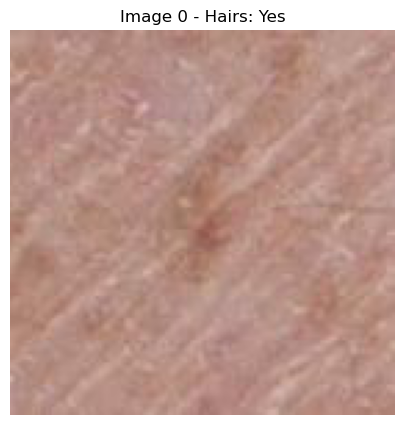

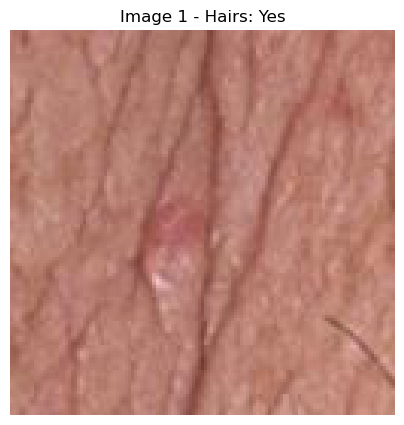

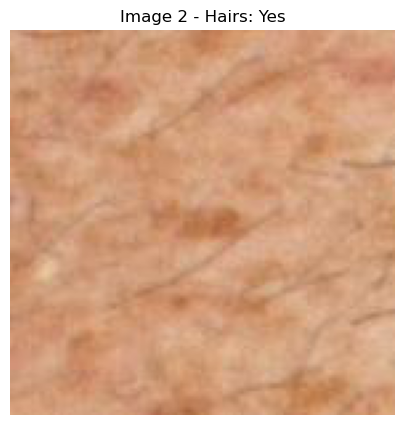

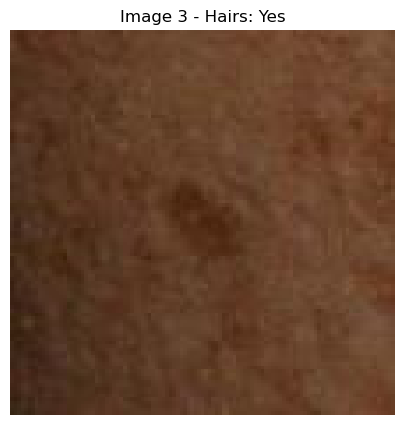

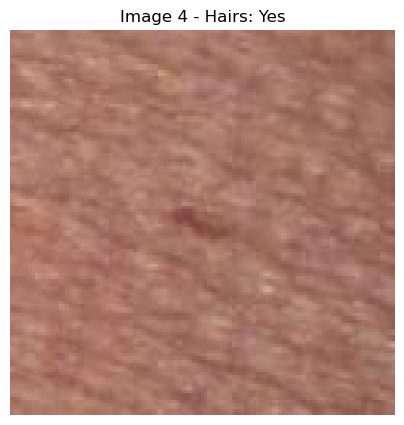

...

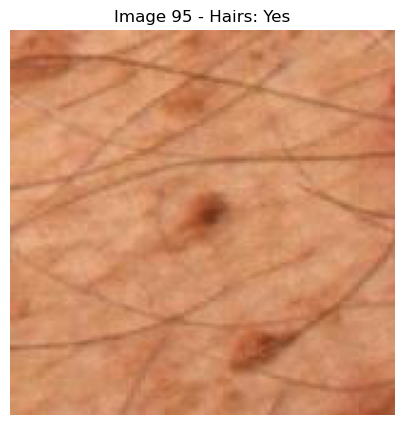

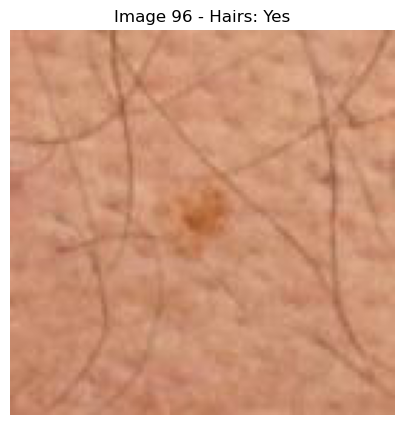

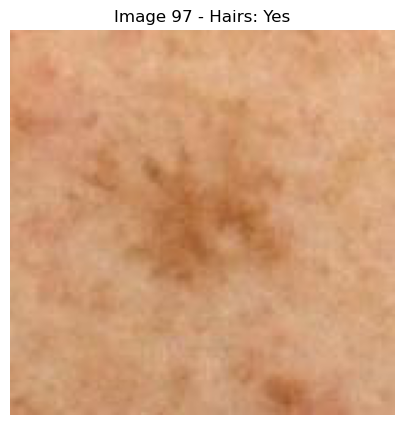

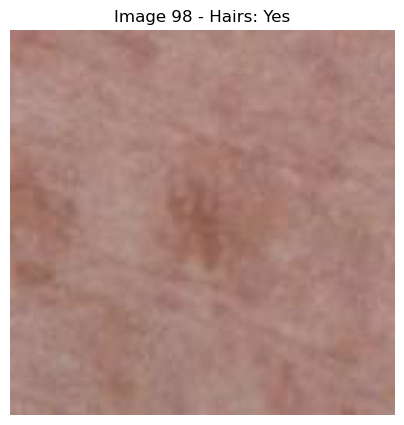

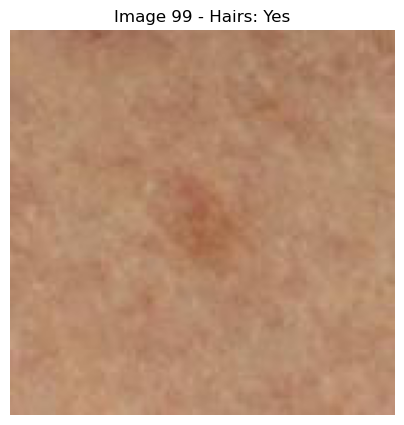

Total images processed: 100
Images with hairs: 100


In [40]:

hdf5_file_path = r"C:\Users\admin\Documents\DSTI\DeepLearning\Project\Computer_Vision\isic-2024-challenge\train-image.hdf5"

def detect_hairs(image_data, crop_pixels=10,dsply_images = False):
    # Load the image using PIL and convert to OpenCV format
    image = Image.open(io.BytesIO(image_data))
    image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    
    height_pixels = len(image) #Image rows
    width_pixels = len(image[0]) #Image columns

    # Image cropping
    height = [crop_pixels, height_pixels - crop_pixels]
    width = [crop_pixels, width_pixels - crop_pixels]
    cropped_img = image[height[0]:height[1], width[0]:width[1]]
    
    # Grayscale
    grayScale = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)
    
    # Black Hat filter
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))
    blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
    
    # Gaussian Blur
    blurred = cv2.GaussianBlur(blackhat, (3, 3), cv2.BORDER_DEFAULT)
    
    # Binary thresholding
    _, mask = cv2.threshold(blurred, 10, 255, cv2.THRESH_BINARY)
    
    # Count the number of pixels detected as hair
    hair_pixels = np.sum(mask > 0)
    
    # Return True if any hair pixels are detected
    return hair_pixels > 0 



def display_and_process_images_with_hairs(hdf5_file_path, start_index, num_images):
    plt.ion()  # Enable interactive mode

    try:
        with h5py.File(hdf5_file_path, 'r') as hdf:
            dataset_ids = list(hdf.keys())
            selected_ids = dataset_ids[start_index:start_index + num_images]

            hair_count = 0

            for i, dataset_id in enumerate(selected_ids):
                data = hdf[dataset_id]
                if isinstance(data, h5py.Dataset) and data.shape == ():
                    image_data = data[()]
                    
                    # Detect hairs
                    has_hairs = detect_hairs(image_data)
                    if has_hairs:
                        hair_count += 1

                    # Display image
                    image = Image.open(io.BytesIO(image_data))
                    plt.figure(figsize=(5, 5))
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title(f'Image {start_index + i} - Hairs: {"Yes" if has_hairs else "No"}')
                    
                    # Show and close
                    plt.draw()
                    plt.pause(0.5)  # Adjust pause as needed
                    plt.clf()
                    plt.close()

            # Display summary
            print(f"Total images processed: {num_images}")
            print(f"Images with hairs: {hair_count}")

    except FileNotFoundError as e:
        print(f"File not found: {e}")
    except Exception as e:
        print(f"An error occurred: {e}")

    plt.ioff()  # Disable interactive mode after processing

display_and_process_images_with_hairs(hdf5_file_path, start_index=0, num_images=100)


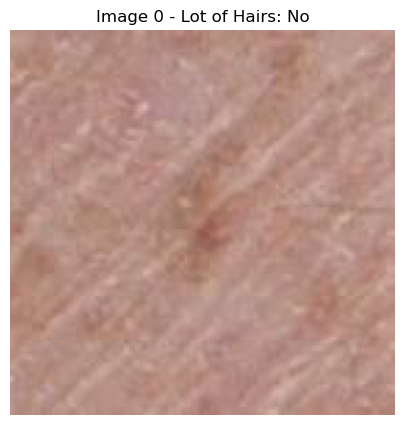

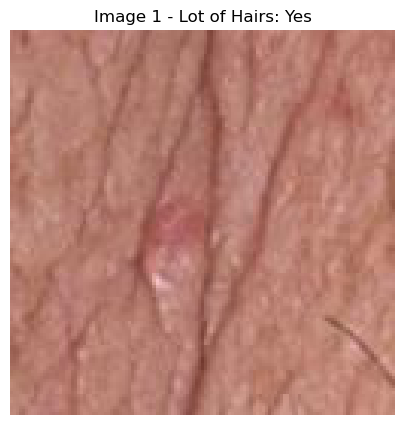

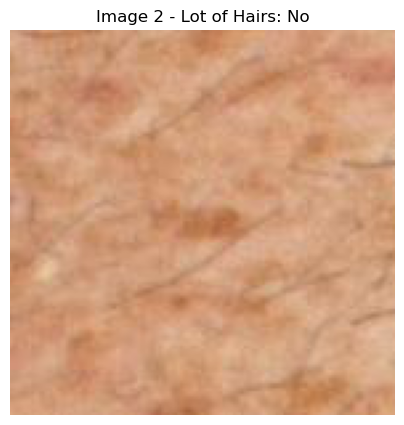

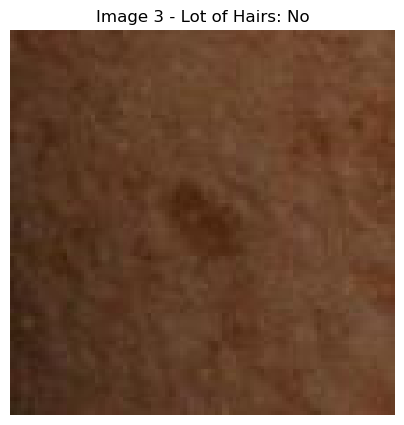

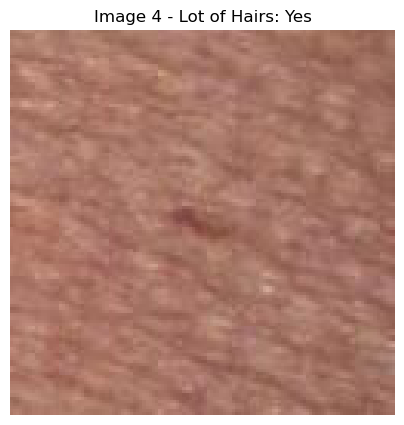

...

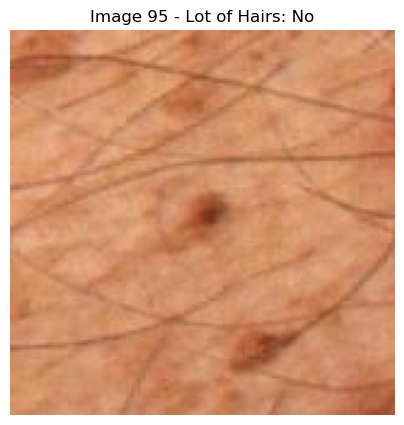

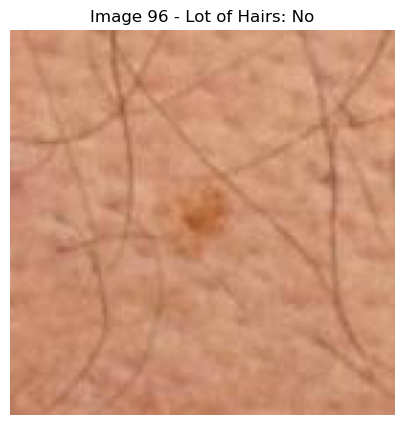

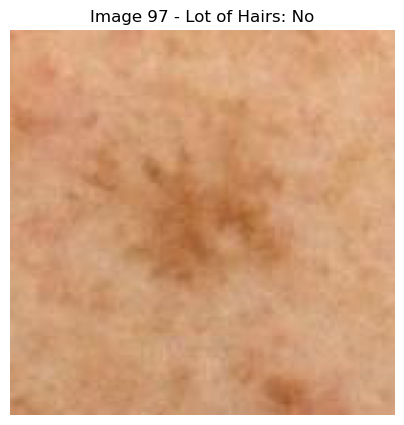

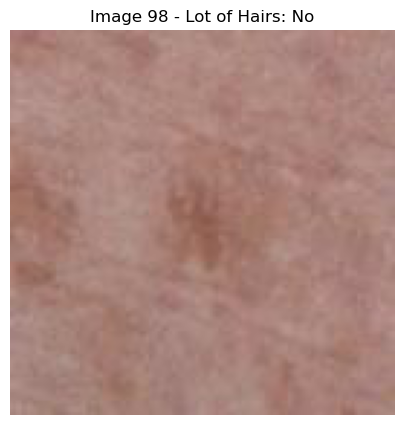

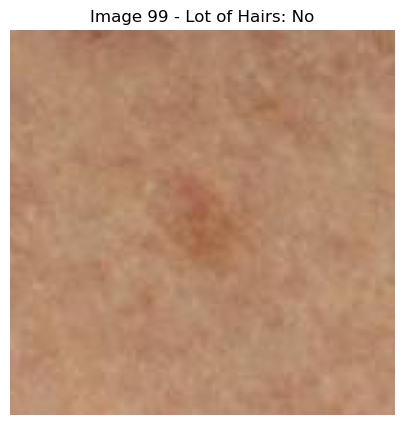

Total images processed: 100
Images with a lot of hairs: 12


In [49]:

hdf5_file_path = r"C:\Users\admin\Documents\DSTI\DeepLearning\Project\Computer_Vision\isic-2024-challenge\train-image.hdf5"

def detect_lot_hairs(image_data, crop_pixels=10, hair_density_threshold=40.0):
    
    # Load image
    image = Image.open(io.BytesIO(image_data))
    image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    
    height_pixels = image.shape[0]  # Image rows
    width_pixels = image.shape[1]   # Image columns

    # Image cropping 
    height = [crop_pixels, height_pixels - crop_pixels]
    width = [crop_pixels, width_pixels - crop_pixels]
    cropped_img = image[height[0]:height[1], width[0]:width[1]]
    
    #Gray sclae
    grayScale = cv2.cvtColor(cropped_img, cv2.COLOR_BGR2GRAY)
    
    # Black Hat filter
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (9, 9))
    blackhat = cv2.morphologyEx(grayScale, cv2.MORPH_BLACKHAT, kernel)
    
    # Gaussian Blur
    blurred = cv2.GaussianBlur(blackhat, (3, 3), cv2.BORDER_DEFAULT)
    
    # Binary thresholding to create a mask
    _, mask = cv2.threshold(blurred, 10, 255, cv2.THRESH_BINARY)
    
    # Calculate the density of hair pixels
    hair_pixels = np.sum(mask > 0)
    total_pixels = mask.size
    hair_density = (hair_pixels / total_pixels) * 100  # Percentage of hair pixels
    
    # Return True if the hair density exceeds the specified threshold
    return hair_density > hair_density_threshold

def display_and_process_images_with_hairs(hdf5_file_path, start_index, num_images):
    plt.ion()  # Enable interactive mode

    try:
        with h5py.File(hdf5_file_path, 'r') as hdf:
            dataset_ids = list(hdf.keys())
            selected_ids = dataset_ids[start_index:start_index + num_images]

            hair_count = 0

            for i, dataset_id in enumerate(selected_ids):
                data = hdf[dataset_id]
                if isinstance(data, h5py.Dataset) and data.shape == ():
                    image_data = data[()]
                    
                    # Detect if the image has a significant amount of hair
                    has_lot_of_hairs = detect_lot_hairs(image_data)
                    if has_lot_of_hairs:
                        hair_count += 1

                    # Display the image
                    image = Image.open(io.BytesIO(image_data))
                    plt.figure(figsize=(5, 5))
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title(f'Image {start_index + i} - Lot of Hairs: {"Yes" if has_lot_of_hairs else "No"}')
                    
                    # Show and close
                    plt.draw()
                    plt.pause(0.5)  
                    plt.clf()
                    plt.close()

            # Display summary
            print(f"Total images processed: {num_images}")
            print(f"Images with a lot of hairs: {hair_count}")

    except FileNotFoundError as e:
        print(f"File not found: {e}")
    except Exception as e:
        print(f"An error occurred: {e}")

    plt.ioff()  # Disable interactive mode after processing


display_and_process_images_with_hairs(hdf5_file_path, start_index=0, num_images=100)


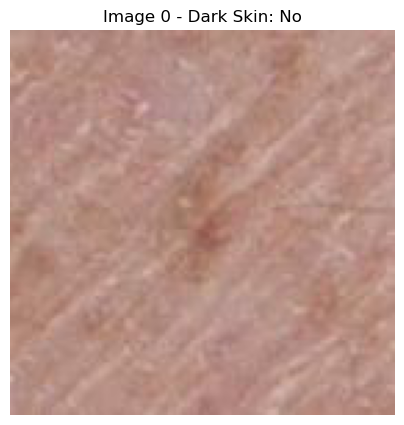

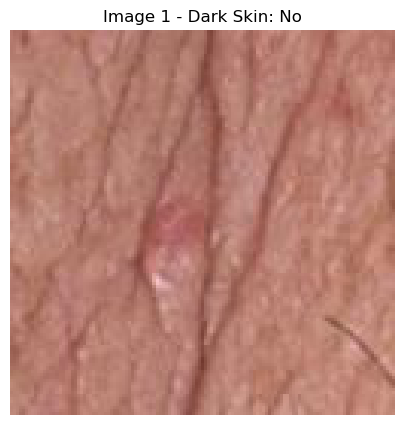

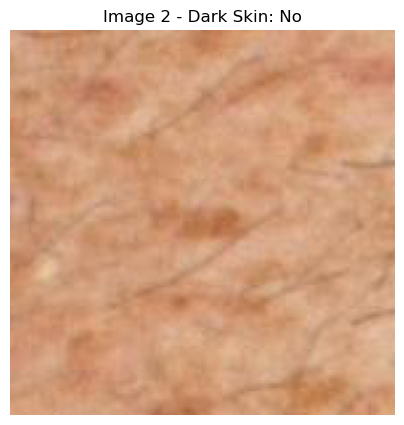

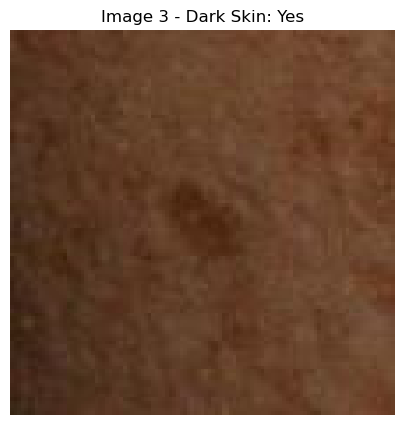

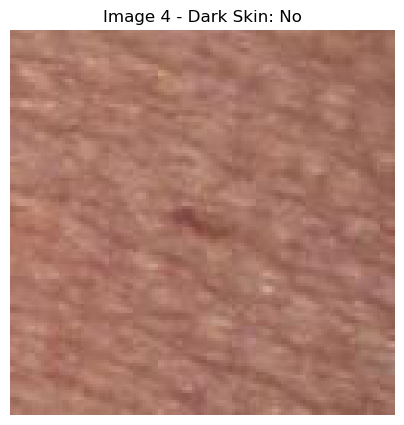

...

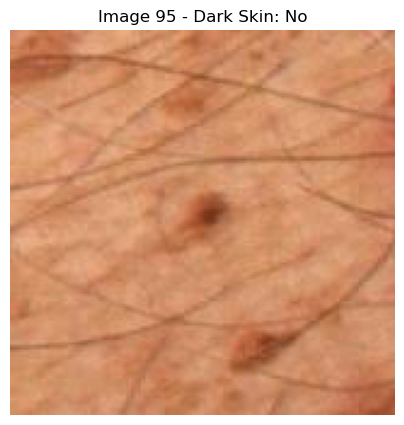

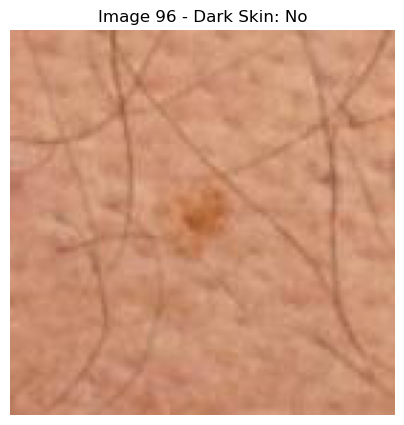

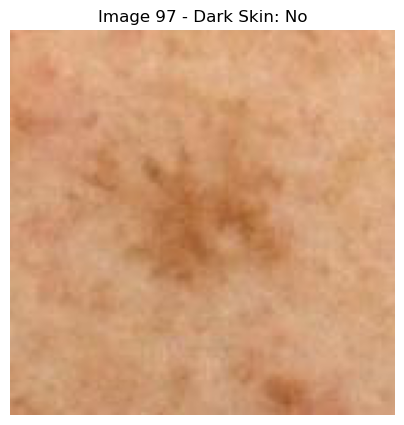

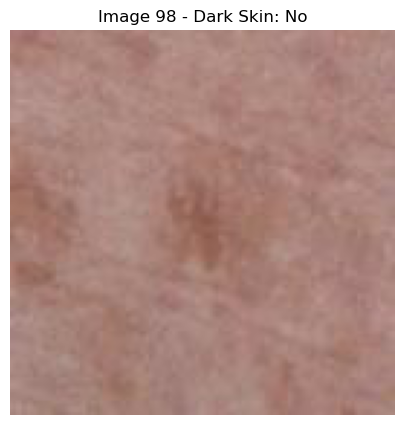

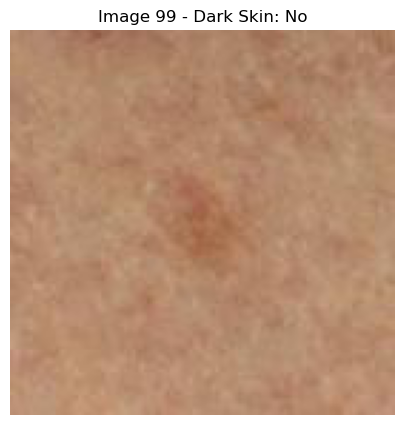

Total images processed: 100
Images with dark skin: 8


In [19]:


hdf5_file_path = r"C:\Users\admin\Documents\DSTI\DeepLearning\Project\Computer_Vision\isic-2024-challenge\train-image.hdf5"

def detect_dark_skin(image_data):
    # Load the image
    image = Image.open(io.BytesIO(image_data))
    image = cv2.cvtColor(np.array(image), cv2.COLOR_RGB2BGR)
    
    # Convert the image to HSV color space
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    
    # HSV range for dark skin tones 
    lower_skin = np.array([0, 80, 60], dtype=np.uint8) #to adapt -difficult to find good reference for the range
    upper_skin = np.array([140, 180, 140], dtype=np.uint8) #to adapt
    
    # Create a mask for dark skin regions
    mask = cv2.inRange(hsv, lower_skin, upper_skin)
    
    # Percentage of dark skin pixels
    skin_pixel_count = np.sum(mask > 0)
    total_pixel_count = mask.size
    skin_pixel_percentage = (skin_pixel_count / total_pixel_count) * 100
    
    # Return True if the percentage of dark skin pixels is above the threshold
    skin_threshold = 50  #to adapt
    return skin_pixel_percentage > skin_threshold

def display_and_process_images(hdf5_file_path, start_index, num_images):
    plt.ion()  # Enable interactive mode

    try:
        with h5py.File(hdf5_file_path, 'r') as hdf:
            dataset_ids = list(hdf.keys())
            selected_ids = dataset_ids[start_index:start_index + num_images]

            dark_skin_count = 0

            for i, dataset_id in enumerate(selected_ids):
                data = hdf[dataset_id]
                if isinstance(data, h5py.Dataset) and data.shape == ():
                    image_data = data[()]
                    
                    # Detect dark skin
                    has_dark_skin = detect_dark_skin(image_data)
                    if has_dark_skin:
                        dark_skin_count += 1

                    # Display the image
                    image = Image.open(io.BytesIO(image_data))
                    plt.figure(figsize=(5, 5))
                    plt.imshow(image)
                    plt.axis('off')
                    plt.title(f'Image {start_index + i} - Dark Skin: {"Yes" if has_dark_skin else "No"}')
                    
                    # Show and close 
                    plt.draw()
                    plt.pause(0.5) 
                    plt.clf()
                    plt.close()

            # Display summary
            print(f"Total images processed: {num_images}")
            print(f"Images with dark skin: {dark_skin_count}")

    except FileNotFoundError as e:
        print(f"File not found: {e}")
    except Exception as e:
        print(f"An error occurred: {e}")

    plt.ioff()  # Disable interactive mode after processing


display_and_process_images(hdf5_file_path, start_index=0, num_images=100)


In [52]:


def extract_image_data_to_csv_in_batches(hdf5_file_path, batch_size, csv_file_path):
    try:
        with h5py.File(hdf5_file_path, 'r') as hdf:
            dataset_ids = list(hdf.keys())
            total_images = len(dataset_ids)
            num_batches = (total_images + batch_size - 1) // batch_size
            
            # Open the CSV file for writing
            with open(csv_file_path, mode='w', newline='') as file:
                writer = csv.writer(file)
                # Write the header
                writer.writerow(['Photo ID', 'Width', 'Height', 'Has Hair', 'Lot of Hair', 'Dark Skin', 'Dark Skin and Lot of Hair'])

                for batch_index in range(num_batches):
                    start_index = batch_index * batch_size
                    end_index = min(start_index + batch_size, total_images)
                    selected_ids = dataset_ids[start_index:end_index]

                    for dataset_id in selected_ids:
                        data = hdf[dataset_id]
                        if isinstance(data, h5py.Dataset) and data.shape == ():
                            image_data = data[()]
                            
                            # Load the image to get dimensions
                            image = Image.open(io.BytesIO(image_data))
                            width, height = image.size

                            # Detect dark skin
                            has_dark_skin = detect_dark_skin(image_data)

                            # Detect hair
                            has_hair = detect_hairs(image_data)
                            lot_of_hair = detect_lot_hairs(image_data)
                        
                            # Determine if both dark skin and a lot of hair are present
                            dark_skin_and_lot_of_hair = has_dark_skin and lot_of_hair

                            # Write the image data to CSV
                            writer.writerow([dataset_id, width, height, 'Yes' if has_hair else 'No', 
                                             'Yes' if lot_of_hair else 'No', 'Yes' if has_dark_skin else 'No', 
                                             'Yes' if dark_skin_and_lot_of_hair else 'No'])

                    print(f"Processed batch {batch_index + 1} of {num_batches}")

        print(f"Data extraction complete. Results saved to {csv_file_path}")

    except FileNotFoundError as e:
        print(f"File not found: {e}")
    except Exception as e:
        print(f"An error occurred: {e}")


csv_file_path = r"C:\Users\admin\Documents\DSTI\DeepLearning\image_data2.csv"
extract_image_data_to_csv_in_batches(hdf5_file_path, batch_size=1000, csv_file_path=csv_file_path)


Processed batch 1 of 402
Processed batch 2 of 402
Processed batch 3 of 402
Processed batch 4 of 402
Processed batch 5 of 402
Processed batch 6 of 402
Processed batch 7 of 402
Processed batch 8 of 402
Processed batch 9 of 402
Processed batch 10 of 402
Processed batch 11 of 402
Processed batch 12 of 402
Processed batch 13 of 402
Processed batch 14 of 402
Processed batch 15 of 402
Processed batch 16 of 402
Processed batch 17 of 402
Processed batch 18 of 402
Processed batch 19 of 402
Processed batch 20 of 402
Processed batch 21 of 402
Processed batch 22 of 402
Processed batch 23 of 402
Processed batch 24 of 402
Processed batch 25 of 402
Processed batch 26 of 402
Processed batch 27 of 402
Processed batch 28 of 402
Processed batch 29 of 402
Processed batch 30 of 402
Processed batch 31 of 402
Processed batch 32 of 402
Processed batch 33 of 402
Processed batch 34 of 402
Processed batch 35 of 402
Processed batch 36 of 402
Processed batch 37 of 402
Processed batch 38 of 402
Processed batch 39 of

Processed batch 309 of 402
Processed batch 310 of 402
Processed batch 311 of 402
Processed batch 312 of 402
Processed batch 313 of 402
Processed batch 314 of 402
Processed batch 315 of 402
Processed batch 316 of 402
Processed batch 317 of 402
Processed batch 318 of 402
Processed batch 319 of 402
Processed batch 320 of 402
Processed batch 321 of 402
Processed batch 322 of 402
Processed batch 323 of 402
Processed batch 324 of 402
Processed batch 325 of 402
Processed batch 326 of 402
Processed batch 327 of 402
Processed batch 328 of 402
Processed batch 329 of 402
Processed batch 330 of 402
Processed batch 331 of 402
Processed batch 332 of 402
Processed batch 333 of 402
Processed batch 334 of 402
Processed batch 335 of 402
Processed batch 336 of 402
Processed batch 337 of 402
Processed batch 338 of 402
Processed batch 339 of 402
Processed batch 340 of 402
Processed batch 341 of 402
Processed batch 342 of 402
Processed batch 343 of 402
Processed batch 344 of 402
Processed batch 345 of 402
P

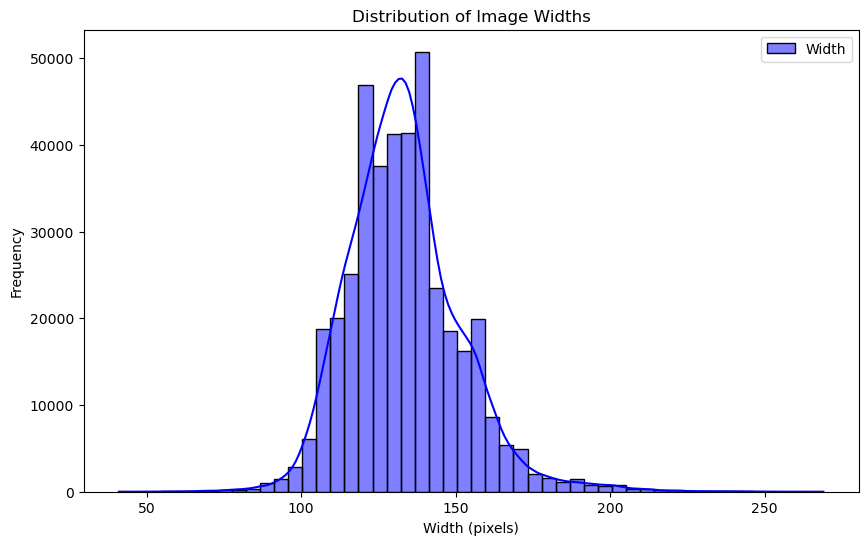

In [53]:


isize = pd.read_csv('image_data2.csv')

# width histo
plt.figure(figsize=(10, 6))
sns.histplot(isize['Width'], bins=50, kde=True, color='blue', label='Width')
plt.title('Distribution of Image Widths')
plt.xlabel('Width (pixels)')
plt.ylabel('Frequency')
plt.legend()
plt.show()

In [54]:
# Define bins for width intervals
bin_edges = range(0, isize[['Width', 'Height']].max().max() + 20, 20) 

# Total number of observations
total_observations = len(isize)

# Table frequencies
isize['Width.Binned'] = pd.cut(isize['Width'], bins=bin_edges)
width_freq = isize['Width.Binned'].value_counts().sort_index()
width_relative_freq = width_freq / total_observations
width_cum_relative_freq = width_relative_freq.cumsum()
df_width = pd.DataFrame({'Width.Interval': width_freq.index.astype(str), 
                         'Frequency': width_relative_freq.values, 
                         'Cumulative.Frequency': width_cum_relative_freq.values})


# Display tables
print("Relative Frequency and Cumulative Relative Frequency - Width")
print(df_width)

Relative Frequency and Cumulative Relative Frequency - Width
   Width.Interval  Frequency  Cumulative.Frequency
0         (0, 20]   0.000000              0.000000
1        (20, 40]   0.000000              0.000000
2        (40, 60]   0.000125              0.000125
3        (60, 80]   0.001302              0.001426
4       (80, 100]   0.014571              0.015998
5      (100, 120]   0.210144              0.226141
6      (120, 140]   0.470469              0.696611
7      (140, 160]   0.232083              0.928694
8      (160, 180]   0.054381              0.983075
9      (180, 200]   0.011933              0.995008
10     (200, 220]   0.003997              0.999005
11     (220, 240]   0.000770              0.999776
12     (240, 260]   0.000219              0.999995
13     (260, 280]   0.000005              1.000000


In [46]:
print(isize.columns)


Index(['Photo ID', 'Width', 'Height', 'Has Hair', 'Lot of Hair', 'Dark Skin',
       'Dark Skin and Lot of Hair', 'Width.Binned'],
      dtype='object')


In [55]:
#calculate nmber of image with these parameters: hair, Dark skin, lot of hairs
hair_count = isize[isize['Has Hair'] == 'Yes'].shape[0]
pourcentage_hair=hair_count/total_observations

lot_hair_count = isize[isize['Lot of Hair'] == 'Yes'].shape[0]
pourcentage_lot_hair=lot_hair_count/total_observations

Dark_skin_count = isize[isize['Dark Skin'] == 'Yes'].shape[0]
pourcentage_Dark_skin=Dark_skin_count/total_observations

Ds_Lh_count = isize[isize['Dark Skin and Lot of Hair'] == 'Yes'].shape[0]
pourcentage_Ds_Lh=Ds_Lh_count/total_observations

# Display
print(f"Number with hair : {hair_count}, Proportion with hair : {pourcentage_hair:.2%}")
print(f"Number with lot of hair : {lot_hair_count}, Proportion with lot of hair : {pourcentage_lot_hair:.2%}")
print(f"Number with dark sin : {Dark_skin_count}, Proportion with dark skin : {pourcentage_Dark_skin:.2%}")
print(f"Number with dark sin and lot of hairs : {Ds_Lh_count}, Proportion with dark skin and lot of hairs : {pourcentage_Ds_Lh:.2%}")

Number with hair : 399902, Proportion with hair : 99.71%
Number with lot of hair : 43395, Proportion with lot of hair : 10.82%
Number with dark sin : 43700, Proportion with dark skin : 10.90%
Number with dark sin and lot of hairs : 3230, Proportion with dark skin and lot of hairs : 0.81%
